# **Real Estate Rental Price Analysis in the US**

# **Part 1** Introduction
For our final project, we sought to better understand the drivers of rental price for various real estate properties across the US. To that end, we selected five datasets.

1. The primary dataset, termed `real_estate_dataset_df`, comprises an array of variables such as rental pricing, geographic loaction, the number of available bedrooms & bathrooms, amongst other pertinent attributes of rental listings.

2. The second dataset, `crime_data_df`, encompasses crime rate statistics across all U.S. states and territories, serving as a proxy for the regional safety.

3. The third dataset, `state_gdp_df`, encapsulates the Gross Domestic Product (GDP) per capita for each state, which we posited as an indicator of the local economic status.

4. The fourth dataset, `weather_score_df`, quantifies the climatic livability, particularly temperature.

5. The final dataset, `spending_merged_df`, conveys the government expenditures across various sectors within each state for the year 2022.

Aggregating, pre-processing these results and merging them with our previous dataset, we are able to develop a holistic understanding of both the intrinsic factors (e.g., room type, facilities available etc) and external factors (crime levels, weather condition, etc.) that drive rental price.

These results are detailed below in our notebook. Above or beneath each relevant visualization or finding, we take care to explain the motivation for the analysis, the key takeaways, and how our findings serve to inform our understanding of the relationships between various internal and external factors and listing price.

We hope you find our findings insightful, and we are eager to answer any questions you may have.

# Imports/Setup
Run the following cells to set up the notebook.


In [ ]:
%%capture
!pip install lxml
!pip install requests
!apt update
!pip install kaggle

In [ ]:
# import packages
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from lxml import html
from typing import Optional
import lxml.etree
import requests
import plotly.graph_objects as go
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from scipy.stats import spearmanr
from sklearn import datasets, linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

import numpy as np

import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import xgboost as xgb
from xgboost.sklearn import XGBRegressor
import datetime
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor

# **Part 2:** Data Loading and Preprocessing
**Main Database Sources:**
We have utilized both web scraping techniques and loading data from CSV files/kaggle to gather all relevant data needed for the project.

- USA Housing Listings:https://www.kaggle.com/datasets/austinreese/usa-housing-listings
- List of U.S. states and territories by GDP: https://en.wikipedia.org/wiki/List_of_U.S._states_and_territories_by_GDP
- Reported violent crime rate in the United States in 2022: https://www.statista.com/statistics/200445/reported-violent-crime-rate-in-the-us-states/
- Average Monthly Temperature by US State: https://www.kaggle.com/datasets/justinrwong/average-monthly-temperature-by-us-state
- State and Local General Expenditures, Per Capita: https://www.taxpolicycenter.org/statistics/state-and-local-general-expenditures-capita


**Supporting data for incomplete datasets:**
Upon carefully analysing the data gathered for each factor, we noticed that there is missing data for weather for a few states. To make up for this, we have utilized the below relevant resource:
- U.S. Climate Normals Quick Access (for temperature data of D.C, Alaska and Hawaii): https://www.ncei.noaa.gov/access/us-climate-normals/#dataset=normals-monthly&timeframe=15&location=HI&station=USC00519603

## **2.1** Real Estate Rental Prices Dataset

### **2.1.1** Read and Load Data
For the Real Estate Rental Prices data we are utilizing this Kaggle [dataset](https://www.kaggle.com/datasets/austinreese/usa-housing-listings). It contains 22 columns and over 3,84,977 property entries.

In [ ]:

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Create the kaggle directory and
# (NOTE: Do NOT run this cell more than once unless restarting kernel)
!mkdir ~/.kaggle

In [ ]:
# Read the uploaded kaggle.json file
!cp /content/drive/MyDrive/kaggle.json ~/.kaggle/

In [ ]:
# Download dataset
!kaggle datasets download -d austinreese/usa-housing-listings

 94% 99.0M/106M [00:02<00:00, 48.3MB/s]
100% 106M/106M [00:02<00:00, 41.1MB/s] 


In [ ]:
# Unzip folder in Colab content folder
!unzip /content/usa-housing-listings.zip

Archive:  /content/usa-housing-listings.zip
  inflating: housing.csv             


In [ ]:
# Read the csv file and save it to a dataframe called "real_estate_dataset_df"
real_estate_dataset_df = pd.read_csv('/content/housing.csv')

# Check out the first five rows
real_estate_dataset_df.head()

,id,url,region,region_url,price,type,sqfeet,beds,baths,cats_allowed,...,wheelchair_access,electric_vehicle_charge,comes_furnished,laundry_options,parking_options,image_url,description,lat,long,state
0,7049044568,https://reno.craigslist.org/apa/d/reno-beautif...,reno / tahoe,https://reno.craigslist.org,1148,apartment,1078,3,2.0,1,...,0,0,0,w/d in unit,carport,https://images.craigslist.org/01616_daghmBUvTC...,Ridgeview by Vintage is where you will find al...,39.5483,-119.796,ca
1,7049047186,https://reno.craigslist.org/apa/d/reno-reduced...,reno / tahoe,https://reno.craigslist.org,1200,condo,1001,2,2.0,0,...,0,0,0,w/d hookups,carport,https://images.craigslist.org/00V0V_5va0MkgO9q...,Conveniently located in the middle town of Ren...,39.5026,-119.789,ca
2,7043634882,https://reno.craigslist.org/apa/d/sparks-state...,reno / tahoe,https://reno.craigslist.org,1813,apartment,1683,2,2.0,1,...,0,0,0,w/d in unit,attached garage,https://images.craigslist.org/00t0t_erYqC6LgB8...,2BD | 2BA | 1683SQFTDiscover exceptional servi...,39.6269,-119.708,ca
3,7049045324,https://reno.craigslist.org/apa/d/reno-1x1-fir...,reno / tahoe,https://reno.craigslist.org,1095,apartment,708,1,1.0,1,...,0,0,0,w/d in unit,carport,https://images.craigslist.org/00303_3HSJz75zlI...,MOVE IN SPECIAL FREE WASHER/DRYER WITH 6 OR 12...,39.4477,-119.771,ca
4,7049043759,https://reno.craigslist.org/apa/d/reno-no-long...,reno / tahoe,https://reno.craigslist.org,289,apartment,250,0,1.0,1,...,1,0,1,laundry on site,NaN,https://images.craigslist.org/01616_fALAWFV8zQ...,"Move In Today: Reno Low-Cost, Clean & Furnishe...",39.5357,-119.805,ca


In [ ]:
real_estate_dataset_df.columns

Index(['id', 'url', 'region', 'region_url', 'price', 'type', 'sqfeet', 'beds',
       'baths', 'cats_allowed', 'dogs_allowed', 'smoking_allowed',
       'wheelchair_access', 'electric_vehicle_charge', 'comes_furnished',
       'laundry_options', 'parking_options', 'image_url', 'description', 'lat',
       'long', 'state'],
      dtype='object')

### **2.1.2** Understanding the Data

To get a better sense of the distribution of our data, we analysed the different numerical and categorical attributes. We also analysed some measures of central tendency as well as some measures of range.

The following columns have boolean values 0, 1:
1. `wheelchair_access`
2. `electric_vehicle_charge`
3. `comes_furnished`
4. `cats_allowed`
5. `dogs_allowed`
6. `smoking_allowed`

The following columns are categorical with string values (potential for applying one hot encoding or target encoding which we have explored in the later sections)
1. `type`
2. `laundry_options`
3. `parking_options`

The following attributes have numerical values:
1. `beds`
2. `baths`
3. `sqfeet`

From the below description we can see that some columns have missing values ('laundry_options', 'parking_options', 'description', 'lat', and 'long'). We can consider this information when dealing with nulls in the dataset.

In [ ]:
# display the datatypes and filled entries in `real_estate_dataset_df`
real_estate_dataset_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 384977 entries, 0 to 384976
Data columns (total 22 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   id                       384977 non-null  int64  
 1   url                      384977 non-null  object 
 2   region                   384977 non-null  object 
 3   region_url               384977 non-null  object 
 4   price                    384977 non-null  int64  
 5   type                     384977 non-null  object 
 6   sqfeet                   384977 non-null  int64  
 7   beds                     384977 non-null  int64  
 8   baths                    384977 non-null  float64
 9   cats_allowed             384977 non-null  int64  
 10  dogs_allowed             384977 non-null  int64  
 11  smoking_allowed          384977 non-null  int64  
 12  wheelchair_access        384977 non-null  int64  
 13  electric_vehicle_charge  384977 non-null  int64  
 14  come

In [ ]:
# display the descriptive statistics of `real_estate_dataset_df`
real_estate_dataset_df.describe()

,id,price,sqfeet,beds,baths,cats_allowed,dogs_allowed,smoking_allowed,wheelchair_access,electric_vehicle_charge,comes_furnished,lat,long
count,3.849770e+05,3.849770e+05,3.849770e+05,384977.000000,384977.000000,384977.000000,384977.000000,384977.000000,384977.000000,384977.000000,384977.000000,383059.000000,383059.000000
mean,7.040982e+09,8.825722e+03,1.059900e+03,1.905345,1.480718,0.726890,0.707918,0.731771,0.082111,0.012871,0.048128,37.233487,-92.700631
std,8.800376e+06,4.462200e+06,1.915076e+04,3.494572,0.618061,0.445557,0.454721,0.443038,0.274535,0.112718,0.214036,5.546171,16.531980
min,7.003808e+09,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-43.533300,-163.894000
25%,7.035979e+09,8.050000e+02,7.500000e+02,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,33.454700,-100.775000
50%,7.043320e+09,1.036000e+03,9.490000e+02,2.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,37.647800,-87.745100
75%,7.048426e+09,1.395000e+03,1.150000e+03,2.000000,2.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,41.138300,-81.179600
max,7.051292e+09,2.768307e+09,8.388607e+06,1100.000000,75.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,102.036000,172.633000


**Few takeaways from this:**
1. The dataset contains a wide range of values, as indicated by the large standard deviations for price and sqfeet. (Ignoring the `id` attribute as it has no relevance when predicting house prices.)
2. There seem to be potential outliers in the dataset, especially in columns like `price` and `sqfeet`, where the maximum values are significantly higher than the 75th percentile.
3. `price` and `sqfeet` also seem to have considerable spread in their data (more on this in visualization section, as seen from the difference between the 75th percentile and the maximum values.)

### **2.1.3** Data Cleaning
- We dropped some uneccessary columns, which have little use when building machine learning model.
- We also drop rows with null values, duplicate entries and a price = $0.
- Type and case casting: Changed the `state` column into uppercase, and cast `beds` and `baths` into integer type.

In [ ]:
# drop url, region-url, image-url, lat, long, region and description columns,
#because these are descriptional infomation about the properties
#that we assume have little influence over the rental price
columns_to_drop = ['id','url', 'region_url', 'image_url', 'region', 'description']
real_estate_dataset_df_cleaned = real_estate_dataset_df.drop(columns_to_drop,axis=1)

# drop rows with null and duplicated values
real_estate_dataset_df_cleaned.dropna(inplace=True)
real_estate_dataset_df_cleaned.drop_duplicates(inplace=True)

# drop row with price equals to 0
real_estate_dataset_df_cleaned = real_estate_dataset_df_cleaned[real_estate_dataset_df_cleaned['price'] != 0]

In [ ]:
# change the state column into uppercase
real_estate_dataset_df_cleaned['state'] = real_estate_dataset_df_cleaned['state'].str.upper()
real_estate_dataset_df_cleaned.rename(columns = {'state': 'State'}, inplace = True)

# cast baths and beds columns into integer type
real_estate_dataset_df_cleaned['baths'] = real_estate_dataset_df_cleaned['baths'].astype(int)
real_estate_dataset_df_cleaned['beds'] = real_estate_dataset_df_cleaned['beds'].astype(int)

<ipython-input-13-7770ed098003>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_estate_dataset_df_cleaned['state'] = real_estate_dataset_df_cleaned['state'].str.upper()
<ipython-input-13-7770ed098003>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_estate_dataset_df_cleaned.rename(columns = {'state': 'State'}, inplace = True)
<ipython-input-13-7770ed098003>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:/

Upon implementing the outlined procedures, we observe a reduction in our dataset from 384,977 rows to 125,687. This adjusted size retains a considerable scale, providing ample data for a thorough exploration of the underlying relationships.

In [ ]:
# display the datatypes and filled entries in `real_estate_dataset_df` after cleaning
real_estate_dataset_df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 125687 entries, 0 to 384974
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   price                    125687 non-null  int64  
 1   type                     125687 non-null  object 
 2   sqfeet                   125687 non-null  int64  
 3   beds                     125687 non-null  int64  
 4   baths                    125687 non-null  int64  
 5   cats_allowed             125687 non-null  int64  
 6   dogs_allowed             125687 non-null  int64  
 7   smoking_allowed          125687 non-null  int64  
 8   wheelchair_access        125687 non-null  int64  
 9   electric_vehicle_charge  125687 non-null  int64  
 10  comes_furnished          125687 non-null  int64  
 11  laundry_options          125687 non-null  object 
 12  parking_options          125687 non-null  object 
 13  lat                      125687 non-null  float64
 14  long

## **2.2** GDP per States Dataset



### **2.2.1** Helper Function for XML Visualization
For web scraping the GDP data, we have first created a function that performs the following steps:

1. `element.text` is stripped of leading and trailing whitespace using the `strip_or_null` helper function. If the element has text, it is indented properly.
2. The function checks if the element has any child elements (`num_children`).
  - If there are children, it recursively calls `indent_lxml` on each child, adjusting the `level` and `is_last_child` parameters accordingly.
  - If there are no children but the element has text, that text is followed by an indent.
3. The `tail` of the element (the text following the element, if it's not the last child) is also processed for proper indentation.
4. The `strip_or_null` helper function is used to either strip whitespace from a string or return `None` if the string is empty or `None`.

In essence, this function goes through an XML element tree and adds indentation and newlines to make the XML structure more human-readable by adjusting the text and tail of each element according to its depth in the tree and its position among siblings.

In [ ]:
## Simple pretty-printer, from https://stackoverflow.com/questions/5086922/python-pretty-xml-printer-with-lxml

from typing import Optional

import lxml.etree

def indent_lxml(element: lxml.etree.Element, level: int = 0, is_last_child: bool = True) -> None:
    space = "  "
    indent_str = "\n" + level * space

    element.text = strip_or_null(element.text)
    if element.text:
        element.text = f"{indent_str}{space}{element.text}"

    num_children = len(element)
    if num_children:
        element.text = f"{element.text or ''}{indent_str}{space}"

        for index, child in enumerate(element.iterchildren()):
            is_last = index == num_children - 1
            indent_lxml(child, level + 1, is_last)

    elif element.text:
        element.text += indent_str

    tail_level = max(0, level - 1) if is_last_child else level
    tail_indent = "\n" + tail_level * space
    tail = strip_or_null(element.tail)
    element.tail = f"{indent_str}{tail}{tail_indent}" if tail else tail_indent


def strip_or_null(text: Optional[str]) -> Optional[str]:
    if text is not None:
        return text.strip() or None

We are using `XPath` for this part of project to finally create a dataframe called `gdp_df` from a Wikipedia [dataset](https://en.wikipedia.org/wiki/List_of_U.S._states_and_territories_by_GDP). The dataset contains 2 columns and 51 entries for GDP of all states.

In [ ]:
w = requests.get("https://en.wikipedia.org/wiki/List_of_U.S._states_and_territories_by_GDP")
dom_tree = html.fromstring(w.content)
print(dom_tree)

indent_lxml(dom_tree)  # corrects indentation "in place"

result = lxml.etree.tostring(dom_tree, encoding="unicode")
# print(result)

<Element html at 0x780b9e7cbab0>


### **2.2.2** Update dom_tree to get only the gdp by states table in 2022
The webpage has multiple tables. To find all of these tables we are using xpath `//table/*`

In [ ]:
for node in dom_tree.xpath("//table/*"):
  result = lxml.etree.tostring(node, encoding="unicode")
  # print('**')
  # print(result)

We are only interested in the table with Nominal GDP values (first table).

So we created an updated_dom_tree to contain the tbody element of the said table.

In [ ]:
updated_dom_tree = dom_tree.xpath('.//tbody')[0]

result = lxml.etree.tostring(updated_dom_tree, encoding="unicode")
# print(result)

### **2.2.3** State Names and GDP
1. Now we first create `x_path_states` and `states`.
  - `x_path_states` is the value  passed into updated_dom_tree.xpath() to retrieve names of the states.
  - `states` is the list in which we store all the names of states we found.
2. Then we create `x_path_gdp` and `gdp`.
  - `x_path_gdp` is the value passed into updated_dom_tree.xpath() to retrieve the gdp of the states.
  - `gdp` is the list we store all the gdp values we found.



In [ ]:
# Get the state names
x_path_states = ".//tr/td[1]/a/text()"
states_raw = updated_dom_tree.xpath(x_path_states)
states = [item.replace('\n', '').replace('\u202f*','').strip() for item in states_raw]

# Get the GDP data
x_path_gdp = ".//tr/td[7]/text()"
gdp_raw = updated_dom_tree.xpath(x_path_gdp)
gdp = [int(item.replace('\n', '').replace(',','').replace('$', '').strip()) for item in gdp_raw]

### **2.2.4** Putting it all together

Created a dataframe called `gdp_df` by using the `states` and `gdp` lists that we created in 2.2.3.

The dataframe have 2 columns. The first should be called `States`. The second should be called `GDP per capita`.

In [ ]:
gdp_df = pd.DataFrame({'States': states, 'GDP per capita': gdp})
gdp_df.sort_values(by=['GDP per capita'], inplace=True, ascending=False)
gdp_df.reset_index(inplace=True, drop=True)
print(gdp_df)

                  States  GDP per capita
0   District of Columbia          242853
1               New York          104344
2          Massachusetts           98609
3           North Dakota           94021
4             Washington           93193
5             California           92190
6            Connecticut           88760
7                 Alaska           86722
8               Delaware           85977
9               Colorado           82954
10              Nebraska           82207
11              Illinois           82126
12               Wyoming           81586
13            New Jersey           80490
14                 Texas           78456
15             Minnesota           78100
16              Maryland           76279
17         New Hampshire           75565
18              Virginia           74789
19          South Dakota           74268
20                  Utah           73424
21                  Iowa           72221
22                Kansas           71729
23          Penn

### **2.2.5** Combining with Foreign Keys
In order to better merge gdp_df with other rental_prices_df, we need to add a foreign key to our dataframe, which stands for the abbreviation for the state names, called `State`. We are using `states_abb_df` which contains the US states and their respective abbreviation. This is our intermediate dataframe that will act as the relationship table so that we can JOIN all data based on the common geographic factor - State.

In [ ]:
# read relationship data (csv) for the states and abbreviations
states_abb_df = pd.read_csv('https://raw.githubusercontent.com/XuanyouLiu/US-Real-Estate-Analysis/main/Datasets/us_states_full_and_abbrev.csv')
states_abb_df.rename(columns={'State Full Name': 'States'}, inplace=True)

# merge state_abb_df with state_gdp_df
state_gdp_df = pd.merge(gdp_df, states_abb_df, on='States')

# cleaning the dataset by renaming and droping columns
state_gdp_df.drop(columns = 'States', inplace = True)
state_gdp_df.rename(columns = {'State Abbreviation': 'State'}, inplace = True)

state_gdp_df

,GDP per capita,State
0,242853,DC
1,104344,NY
2,98609,MA
3,94021,ND
4,93193,WA
5,92190,CA
6,88760,CT
7,86722,AK
8,85977,DE
9,82954,CO


## **2.3** Crime Rate Dataset

### **2.3.1** Read and Load Data
We are using one Excel file for this part of project, `crime_data_df` from a govenment [Website](https://www.statista.com/statistics/200445/reported-violent-crime-rate-in-the-us-states/). The dataset contains 2 columns and over 51 property entries.

In [ ]:
# read the xlsx file
data_file = 'https://raw.githubusercontent.com/XuanyouLiu/US-Real-Estate-Analysis/main/Datasets/reported_violent_crimes_usa_2022.xlsx'
crime_data_df = pd.read_excel(data_file)

### **2.3.2** Understanding the data

This dataset has the following two columns:
1. `State` - categorical
2. `Crime Rate` - continuous

### **2.3.3** Combining with Foreign Keys
Same as 2.2.5

In [ ]:
# create the a map for the full name and abbreviation of each state
states_list = states_abb_df['State Abbreviation'].tolist()
abbreviation_map = dict(zip(states_abb_df['States'], states_abb_df['State Abbreviation']))

# map the data
crime_data_df['Abbreviated'] = crime_data_df['State'].map(abbreviation_map)
crime_data_df['State'] = crime_data_df['Abbreviated']

# drop unecessary column
crime_data_df.drop(columns=["Abbreviated"], inplace=True)
crime_data_df

,State,Crime Rate
0,DC,812.3
1,NM,780.5
2,AK,758.9
3,AR,645.3
4,LA,628.6
5,TN,621.6
6,CA,499.5
7,CO,492.5
8,SC,491.3
9,MO,488.0


## **2.4** Weather per State Dataset

### **2.4.1** Read and Load Data
We are using a CSV for this part of the project, `weather_df` from a kaggle [dataset](https://www.kaggle.com/datasets/justinrwong/average-monthly-temperature-by-us-state/). The dataset contains 2 columns and over 51 property entries.

In [ ]:
weather_df = pd.read_csv('https://raw.githubusercontent.com/XuanyouLiu/US-Real-Estate-Analysis/main/Datasets/average_monthly_temperature_by_state_1950-2022.csv')
weather_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41856 entries, 0 to 41855
Data columns (total 8 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Unnamed: 0                      41856 non-null  int64  
 1   month                           41856 non-null  int64  
 2   year                            41856 non-null  int64  
 3   state                           41856 non-null  object 
 4   average_temp                    41856 non-null  float64
 5   monthly_mean_from_1901_to_2000  41856 non-null  float64
 6   centroid_lon                    41856 non-null  float64
 7   centroid_lat                    41856 non-null  float64
dtypes: float64(4), int64(3), object(1)
memory usage: 2.6+ MB


In [ ]:
# only keep the data from 2012 to 2022
weather_df = weather_df[weather_df['year'] >= 2012]
# drop the columns that are not needed
weather_cleaned_df = weather_df.drop(columns=['Unnamed: 0', 'monthly_mean_from_1901_to_2000', 'centroid_lon', 'centroid_lat'])
weather_cleaned_df

,month,year,state,average_temp
35712,1,2012,Alabama,49.7
35713,1,2012,Arizona,42.6
35714,1,2012,Arkansas,44.0
35715,1,2012,California,44.6
35716,1,2012,Colorado,26.9
...,...,...,...,...
41851,8,2022,Virginia,75.9
41852,8,2022,Washington,68.9
41853,8,2022,West Virginia,72.4
41854,8,2022,Wisconsin,68.3


### **2.4.2** Weather Evaluation

When evaluating the livability of an area based on its weather, relying solely on the average temperature of each state can lead to inaccuracies. For instance, a state that experiences extremely high temperatures in the summer and frigid conditions in the winter may have deceptively moderate annual temperature when averaged, misleading our algorithm.

Thus, it becomes necessary to establish a monthly-based weather assessment criterion to more accurately measure the livability of an area. This approach would take into account the specific climatic conditions experienced each month, allowing for a better understanding of the weather patterns accross the whole year.

**Evaluation and Scoring Rules:**

1. **Comfort Temperature Range:**

First we defined a widely accepted outdoor comfort temperature range, between 64.4°F to 75.2°F. This is in accordance with the statistics of the World Health Organization(WHO).

2. **Monthly Temperature Score:**

- Then we assigned a score for each month depending on how closely the average temperature aligns with the comfort range and established the following scoring system:

- Full points (10 points) are given for temperatures within the range.
Points deducted for temperatures outside this range (Deduction of 1 point for every 3°F difference) down to a minimum score.
The minimum possible score is 0.

3. **Extreme Temperature Events Penalty:**

We are also penalizing months with extreme temperature events (e.g., heatwaves above 86°F or cold snaps below 50°F) by reducing their score by 5 points.

4. **Annual Livability Score:**

The annual livability score is then caluclated by averaging the monthly scores, and then express this as a percentage of the maximum possible score.

In [ ]:
# build up evalutaion function
def weather_score(temperature):
    score = 0
    if 64.4 <= temperature <= 75.2:
        score = 10
    elif temperature < 64.4:
        score = 10 - (64.4 - temperature) / 3
    elif temperature > 75.2:
        score = 10 - (temperature - 75.2) / 3

    if score < 0:
        score = 0

    if temperature < 50 or temperature > 86:
        score = score - 5

    return score

In [ ]:
# add a new column to the dataframe
weather_cleaned_df['weather_score'] = weather_cleaned_df['average_temp'].apply(weather_score)

In [ ]:
# calculate the average score of each season of each state
weather_score_df = weather_cleaned_df.groupby(['state'])['weather_score'].mean().reset_index()
weather_score_df.sort_values(by=['weather_score'], ascending=False, inplace=True)
weather_score_df.reset_index(drop=True, inplace=True)
weather_score_df['weather_score'] = weather_score_df['weather_score'].apply(lambda x: round((x/10) * 100, 2))

### **2.4.3** Combining with Foreign Keys
Same as 2.2.5

In [ ]:
# read the relationship dataset form csv file
# read relationship data (csv) for the states and abbreviations
states_abb_df = pd.read_csv('https://raw.githubusercontent.com/XuanyouLiu/US-Real-Estate-Analysis/main/Datasets/us_states_full_and_abbrev.csv')
states_abb_df.rename(columns={'State Full Name': 'state'}, inplace=True)
weather_score_df_merge = weather_score_df.merge(states_abb_df, on='state', how = 'right')

### **2.4.4** Making up for the missing data
By using `isnull` function we can see the previous `weather_score_df_merge` do not have data for the following three areas: **Alaska, Hawaii and D.C.**

Therefore, we need to find the weather data and calculate the scores for them independently. Finally we can have a complete dataframe for all 51 states and terrotories.

In [ ]:
weather_score_df_merge[weather_score_df_merge['weather_score'].isnull()]

,state,weather_score,State Abbreviation
1,Alaska,NaN,AK
10,Hawaii,NaN,HI
50,District of Columbia,NaN,DC


In [ ]:
# since the weather data does not have the data for the state of Alaska, Hawaii and DC, we need to fill it with other dataset
# read the csv file for the monthly dataset of temperature in Hawaii from 2006 to 2020
hawaii_df = pd.read_csv('https://raw.githubusercontent.com/XuanyouLiu/US-Real-Estate-Analysis/main/Datasets/Hawaii-monthly-2006-2020.csv')

# only keep month and average temperature columns
hawaii_df = hawaii_df[['DATE', 'MLY-TAVG-NORMAL']]

# rename the columns
hawaii_df.rename(columns={'DATE': 'month', 'MLY-TAVG-NORMAL': 'average_temp'}, inplace=True)

# calculate the season of each month
hawaii_df['score'] = hawaii_df['average_temp'].apply(weather_score)

# calculate the average average score
hawaii_score = hawaii_df['score'].mean()/10 * 100

# add the average score to the weather score dataframe
weather_score_df_merge.loc[10, 'weather_score'] = round(hawaii_score, 2)

In [ ]:
# read the csv file for the monthly dataset of temperature in Alaska from 2006 to 2020
alaska_df = pd.read_csv('https://raw.githubusercontent.com/XuanyouLiu/US-Real-Estate-Analysis/main/Datasets/Alaska-monthly-2006-2020.csv')

# only keep month and average temperature columns
alaska_df = alaska_df[['DATE', 'MLY-TAVG-NORMAL']]

# rename the columns
alaska_df.rename(columns={'DATE': 'month', 'MLY-TAVG-NORMAL': 'average_temp'}, inplace=True)

# calculate the season of each month
alaska_df['score'] = alaska_df['average_temp'].apply(weather_score)

# calculate the average average score
alaska_score = alaska_df['score'].mean()/10 * 100

# add the average score to the weather score dataframe
weather_score_df_merge.loc[1, 'weather_score'] = round(alaska_score, 2)

In [ ]:
# read the csv file for the monthly dataset of temperature in DC from 1871 to 2022
dc_df = pd.read_csv('https://raw.githubusercontent.com/XuanyouLiu/US-Real-Estate-Analysis/main/Datasets/DC-monthly-1871-2022.csv')

# only keep rows that is form 2012 to 2022
dc_df = dc_df[dc_df['YEAR'] >= 2012].reset_index(drop = True)

# drop YEAR column
dc_df.drop(columns=['YEAR'], inplace=True)

# calculate the score for each month
dc_score = []

for col in dc_df.columns:
    dc_score.append(dc_df[col].apply(weather_score).mean())

dc_score = (sum(dc_score)/len(dc_score))/10 * 100

# add the average score to the weather score dataframe
weather_score_df_merge.loc[50, 'weather_score'] = round(dc_score, 2)

### **2.4.5** Sort the data by weather score

In [ ]:
weather_score_df_merge.sort_values(by=['weather_score'], ascending=False, inplace=True)
weather_score_df_merge.reset_index(drop=True, inplace=True)
weather_score_df_merge.drop(columns = ['state'], inplace = True)
weather_score_df_merge.rename(columns = {'State Abbreviation': 'State'}, inplace = True)
weather_score_df = weather_score_df_merge
weather_score_df

,weather_score,State
0,97.03,HI
1,90.42,FL
2,79.93,LA
3,76.38,GA
4,71.60,TX
5,71.48,AL
6,71.01,MS
7,70.29,SC
8,61.04,CA
9,57.88,AZ


## **2.5** Government spending per State Dataset

### **2.5.1** Read and Load Data
We are using one CSV for this part of project, `spending_df` from a government [website](https://www.taxpolicycenter.org/statistics/state-and-local-general-expenditures-capita). The dataset contains 10 columns and over 51 property entries.

In [ ]:
# read csv file of spending data
spending_df = pd.read_csv("https://raw.githubusercontent.com/XuanyouLiu/US-Real-Estate-Analysis/main/Datasets/spending.csv")
spending_df.head()

,Region and State,Total,Elementary and Secondary Education,Higher Education,Public Welfare,Public Hospitals,Highways,Police,Other,Population (Thousands)
0,Connecticut......................................,"10,456","2,855",970,"1,062",818,596,361,"3,795","3,623"
1,Maine............................................,"10,191","2,279",608,"3,077",358,813,256,"2,799","1,377"
2,Massachusetts....................................,"13,061","2,775",712,"3,885",587,488,352,"4,262","6,990"
3,New Hampshire....................................,"9,477","2,380",685,"2,201",211,573,350,"3,076","1,388"
4,Rhode Island.....................................,"11,964","2,583",663,"3,157",805,620,451,"3,670","1,097"


### **2.5.2** Data Cleaning
We performed the following steps to pre process the Spendings data
- Removed the unnecessary dots `.` in `Region and State` column
- Casted the String into integer for different Spending Columns
- Stored the dataset in `spending_cleaned_df`
- Renamed columns for better understanding

In [ ]:
# cleaning the data
spending_cleaned_df = spending_df.copy()
spending_cleaned_df['Region and State'] = spending_df['Region and State'].str.replace('.', '').str.strip()
spending_cleaned_df.rename(columns={'Region and State': 'State'}, inplace=True)

# cast the string to int
cols = spending_cleaned_df.columns[1:]

for col in cols:
    spending_cleaned_df[col] = spending_cleaned_df[col].str.replace(',', '')
    spending_cleaned_df[col] = spending_cleaned_df[col].astype(int)

# rename some columns for better intuition
column_name_mapping = {
    'Public Welfare': 'Spendings on Public Welfare',
    'Public Hospitals': 'Spendings on Public Hospitals',
    'Highways': 'Spending on Highways',
    'Police': 'Spending on Police'
}

spending_cleaned_df.rename(columns=column_name_mapping, inplace=True)

<ipython-input-36-963daae6cf83>:3: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  spending_cleaned_df['Region and State'] = spending_df['Region and State'].str.replace('.', '').str.strip()


### **2.5.3** Combining with Foreign Keys
Same as 2.2.5

In [ ]:
# read csv file of states and abbreviations
states_df = pd.read_csv("https://raw.githubusercontent.com/prekshi99/CIS-595-Big-Data-Project/main/datasets/us_states_full_and_abbrev.csv")
states_df.rename(columns={'State Full Name': 'State'}, inplace=True)

# merge two dataframes
spending_merged_df = pd.merge(spending_cleaned_df, states_df, on="State")
spending_merged_df.drop(columns = ['State'], inplace = True)
spending_merged_df.rename(columns = {'State Abbreviation': 'State'}, inplace = True)
spending_merged_df

,Total,Elementary and Secondary Education,Higher Education,Spendings on Public Welfare,Spendings on Public Hospitals,Spending on Highways,Spending on Police,Other,Population (Thousands),State
0,10456,2855,970,1062,818,596,361,3795,3623,CT
1,10191,2279,608,3077,358,813,256,2799,1377,ME
2,13061,2775,712,3885,587,488,352,4262,6990,MA
3,9477,2380,685,2201,211,573,350,3076,1388,NH
4,11964,2583,663,3157,805,620,451,3670,1097,RI
5,13678,2944,1285,3195,739,1138,437,3941,647,VT
6,12638,2300,1572,3135,662,800,392,3776,1005,DE
7,25061,4952,251,7045,2449,1004,1000,8360,669,DC
8,11714,2475,1152,2736,571,488,510,3781,6175,MD
9,11267,2956,711,2396,573,468,455,3706,9268,NJ


## **2.6** JOINING ALL the Preprocessed Datasets
Merge `real_estate_dataset_df_cleaned`, `crime_data_df`, `weather_score_df` together using `left` join method, and drop unnecessary columns

In [ ]:
# merge real_estate_dataset_df_cleaned and state_gdp_df
merged_df = pd.merge(real_estate_dataset_df_cleaned, state_gdp_df, how='left', on='State')

# merge with crime_data_df
merged_df = pd.merge(merged_df, crime_data_df, how='left', on='State')

# merge with weather_score_df
merged_df = pd.merge(merged_df, weather_score_df, how='left', on = 'State')

# merge with spending_merged_df
merged_df = pd.merge(merged_df, spending_merged_df, how='left', on='State')

# Drop unnecessary `Total` column
merged_df = merged_df.drop(columns = ['Total', 'Other'])

merged_df

,price,type,sqfeet,beds,baths,cats_allowed,dogs_allowed,smoking_allowed,wheelchair_access,electric_vehicle_charge,...,GDP per capita,Crime Rate,weather_score,Elementary and Secondary Education,Higher Education,Spendings on Public Welfare,Spendings on Public Hospitals,Spending on Highways,Spending on Police,Population (Thousands)
0,1148,apartment,1078,3,2,1,1,0,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
1,1200,condo,1001,2,2,0,0,0,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
2,1813,apartment,1683,2,2,1,1,1,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
3,1095,apartment,708,1,1,1,1,1,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
4,935,apartment,661,1,1,1,1,1,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125682,1600,cottage/cabin,900,2,1,1,1,0,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
125683,1850,apartment,1090,2,2,1,1,0,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
125684,1149,apartment,840,2,1,1,1,1,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
125685,1426,apartment,1020,2,2,1,1,1,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143


# Saving the Prepocessed in Git and retrieving (Checkpoint)

In [ ]:
merged_df = pd.read_csv('https://raw.githubusercontent.com/XuanyouLiu/US-Real-Estate-Analysis/main/Datasets/preprocessed_data.csv')

# **Part 3:** Exploratory Data Analysis (EDA)



## **3.1** Correlation Matrix to Understand Correlation Between Various Features

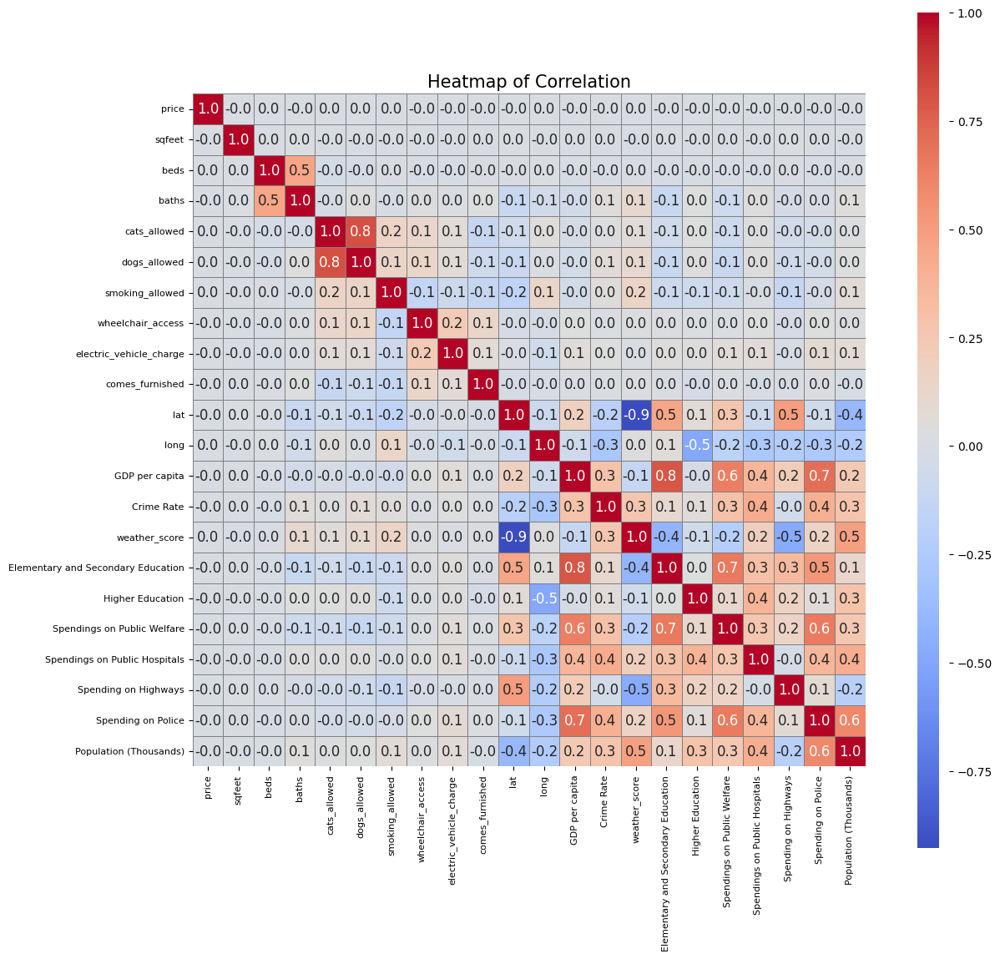

In [ ]:
corrl = merged_df.corr(numeric_only = True)
plt.figure(figsize=(13, 13))
sns.heatmap(corrl,
            cbar=True,
            square=True,
            fmt='.1f',
            annot=True,
            annot_kws={'size': 12},
            cmap='coolwarm',
            linewidths=.5,
            linecolor='gray')

# Adjusting the color bar size to match the heatmap
cbar = plt.gcf().axes[-1]
cbar.set_aspect(20)

# Adjusting the title
plt.title('Heatmap of Correlation', fontsize=15)

# Adjusting the font size of the x and y labels
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.show()

**Takeaways:**
From the above correlation matrix, we can derive following conclusions:

1. `cats_allowed` and `dogs_allowed` are highly correlated, so can combine them into a single attribute called `pets_allowed` and analyze how this affects the rental prices.

2. House related properties like beds, baths, comes_furnished seem to have no direct correlation with the price.

3.  The socio-economic factors also seem to have no direct correlation with the price. This can mean that they might have non-linear relationship with the price or we need to deal with outliers (explored in the next section). Handling outliers can help in reducing skewness of the distribution of our data. By removing extreme values, we can make the distribution more symmetric, which can help in achieving a better correlation.

## **3.2** Analysing, handling outliers, redrawing correlation matrix

### **3.2.1** Anaylsis for outliers
In this section we have analyzed the dataset to spot potential outliers. In the later sections we plan to see how the model performs with and without these outliers.

#### **3.2.1.1** Understanding distribution of factors - Price

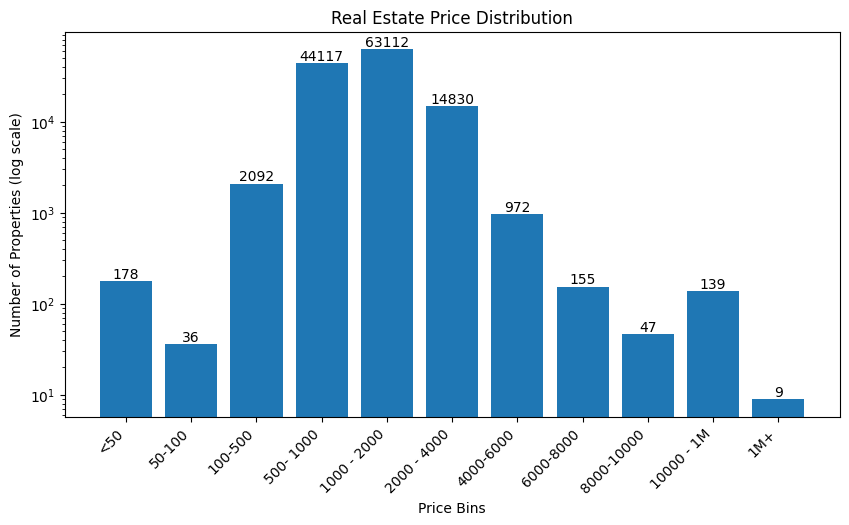

In [ ]:
# data
price_data = merged_df['price']

# binning
bins = [0, 50, 100, 500, 1000, 2000, 4000, 6000, 8000, 10000, 1000000, 3000000000]
bin_labels = ['<50', '50-100', '100-500', '500- 1000', '1000 - 2000', '2000 - 4000', '4000-6000', '6000-8000', '8000-10000', '10000 - 1M', '1M+']

# number of data points in each bin
bin_counts = np.histogram(price_data, bins=bins)[0]

# the binning plot
plt.figure(figsize=(10, 5))
plt.bar(bin_labels, bin_counts)
plt.yscale('log')

plt.xlabel('Price Bins')
plt.ylabel('Number of Properties (log scale)')
plt.title('Real Estate Price Distribution')

# print count on top of each bar
for i, count in enumerate(bin_counts):
    plt.text(i, count, str(count), ha='center', va='bottom')

plt.xticks(rotation=45, ha='right')

plt.show()

Takeaways:
1. From the above distribution we can infer that very small amount of properties \~ 178 have rental price less than \$50 and even smaller number of properties \~36 fall in the price bin \$50-100
2. Number of properties faling in range of \$6000-\$1M+ are also relatively very low in number
3. Majority of the properties \~(44117 + 63112 + 14830 = 122k) fall in the price bin \$500-4000
4. We can use this information to analyze the behaviour of our model once without dropping the outliers evident from the plot and once with dropping these outliers (explored in the modeling section)

#### **3.2.1.2** Understanding distribution of factors - sqfeet

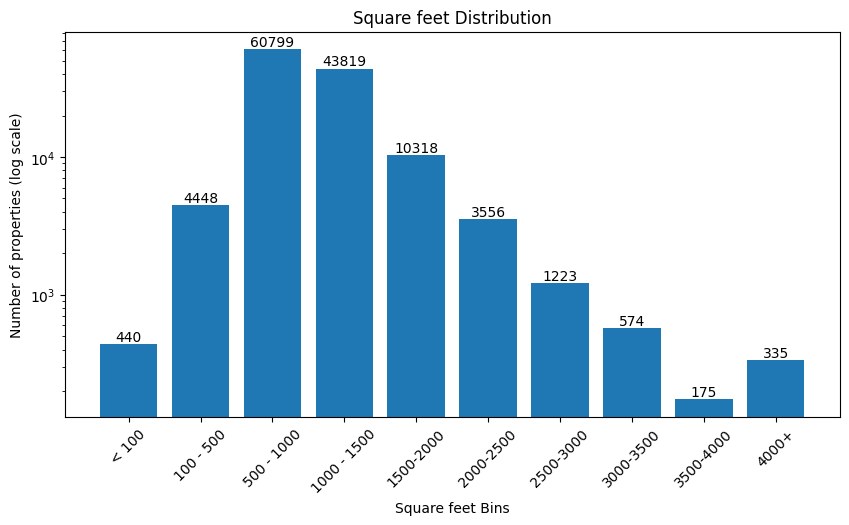

In [ ]:
# data
sqfeet_data = merged_df['sqfeet']

# binning
bins = [0, 100, 500, 1000, 1500, 2000, 2500, 3000, 3500, 4000, 9000000]
bin_labels = ['< 100', '100 - 500', '500 - 1000', '1000 - 1500', '1500-2000', '2000-2500', '2500-3000', '3000-3500', '3500-4000', '4000+']

# number of data points in each bin
bin_counts = np.histogram(sqfeet_data, bins=bins)[0]


# colors = ['skyblue', 'lightgreen', 'lightcoral', 'orange', 'lightblue', 'pink', 'yellow', 'purple', 'brown']

# the binning plot
plt.figure(figsize=(10, 5))
plt.bar(bin_labels, bin_counts)
plt.yscale('log')


plt.xlabel('Square feet Bins')
plt.ylabel('Number of properties (log scale)')
plt.title('Square feet Distribution')
plt.xticks(rotation=45)
# print count on top of each bar
for i, count in enumerate(bin_counts):
    plt.text(i, count, str(count), ha='center', va='bottom')
plt.show()

**Takeaway:**

1. From the above distribution we can infer that relatively very small number of properties \~ 415 have square feet \< 100 and around \~ 510 properties have square feet \> 3500
2. Majority of the properties \~(44117 + 63112 + 14830 = 122k) fall in the price bin \$500-3500
3. We can use this information to analyze the behaviour of our model once without dropping the outliers evident from the plot and once with dropping these outliers (explored in the modeling section)

#### **3.2.1.3** Understanding distribution of factors - beds and baths

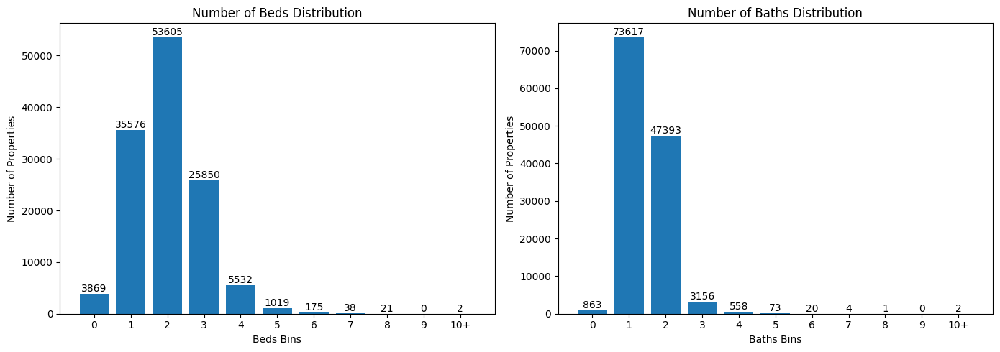

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

bath_data = merged_df['baths']

bed_data = merged_df['beds']

# Binning for beds
bed_bins = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1500]
bed_bin_labels = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10+']
bed_bin_counts = np.histogram(bed_data, bins=bed_bins)[0]

# Binning for baths
bath_bins = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 1500]
bath_bin_labels = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10+']
bath_bin_counts = np.histogram(bath_data, bins=bath_bins)[0]

# Plotting beds distribution
plt.figure(figsize=(14, 5))

plt.subplot(1, 2, 1)
plt.bar(bed_bin_labels, bed_bin_counts)
plt.xlabel('Beds Bins')
plt.ylabel('Number of Properties')
plt.title('Number of Beds Distribution')
for i, count in enumerate(bed_bin_counts):
    plt.text(i, count, str(count), ha='center', va='bottom')

# Plotting baths distribution
plt.subplot(1, 2, 2)
plt.bar(bath_bin_labels, bath_bin_counts)
plt.xlabel('Baths Bins')
plt.ylabel('Number of Properties')
plt.title('Number of Baths Distribution')
for i, count in enumerate(bath_bin_counts):
    plt.text(i, count, str(count), ha='center', va='bottom')

plt.tight_layout()
plt.show()

**Takeaways:**
1. Majoirty of the properties have beds in range [0, 5] and baths in range  [0, 4]
2. We also have data for properties with large number of beds and bath
3. Potential outliers in this case can be properties with beds and baths count more than 5 and 4 respectively.

### **3.2.3** Removing outliers based on findings from above sections (Checkpoint)
In this section, we created a dataframe `merged_df_without_outliers` and analysed how it affects the correlation matrix and in future, the model performance.
To this end, we have performed the following operations:
1. Remove rows with price values less than \$100 and greater than \$10k
2. Remove rows with sqfeet values less than 100
3. Remove rows with beds \>5 and baths \>4
4. Plot the correlation matrix to see how this affects the relationships between various factors.

In [ ]:
# Remove rows with price values less than $100 and greater than $10k
merged_df_without_outliers = merged_df[(merged_df['price'] >= 100) & (merged_df['price'] <= 10000)]

# Remove rows with sqfeet values less than 100
merged_df_without_outliers = merged_df_without_outliers[merged_df_without_outliers['sqfeet'] >= 100]

# Remove rows with beds > 5 and baths > 4
merged_df_without_outliers = merged_df_without_outliers[(merged_df_without_outliers['beds'] <= 5) & (merged_df_without_outliers['baths'] <= 4)]

### **3.2.2** Correlation Matrix (After removing outliers)


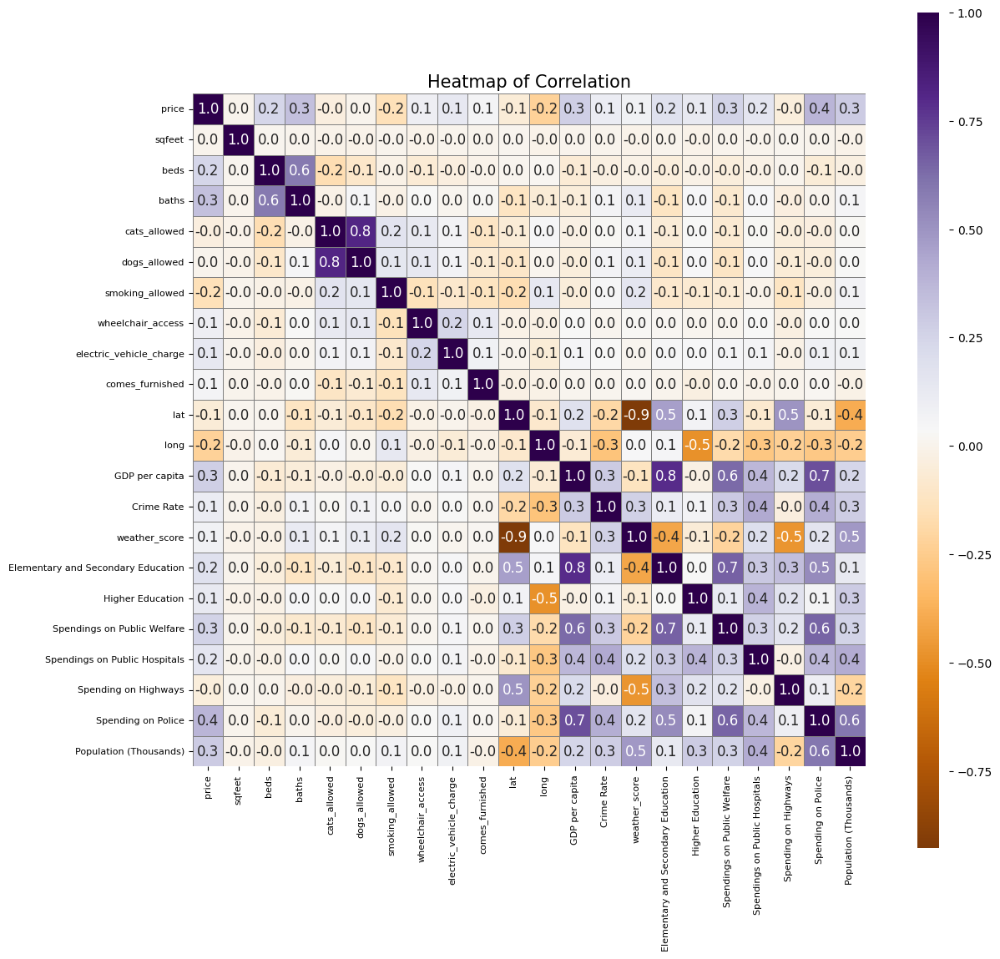

In [ ]:
# Plot the correlation matrix
correlation_matrix = merged_df_without_outliers.corr(numeric_only = True)
plt.figure(figsize=(13, 13))
sns.heatmap(correlation_matrix,
            cbar=True,
            square=True,
            fmt='.1f',
            annot=True,
            annot_kws={'size': 12},
            cmap='PuOr',
            linewidths=.5,
            linecolor='gray')

# Adjusting the color bar size to match the heatmap
cbar = plt.gcf().axes[-1]
cbar.set_aspect(20)

# Adjusting the title
plt.title('Heatmap of Correlation', fontsize=15)

# Adjusting the font size of the x and y labels
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.show()

##**Takeaways**
1. From the above correlation map we can infer that price is correlated in some capacity with various socio-economic factors such as Population, Spending on Police, Spendings on Public Welfare, Education etc
2. Price is also correlated to some of the house properties notably baths, beds, laundry and parking options.
3. We also see a negative correlations between price and smoking_allowed. This can be explained by the fact that as the properties move into the moderate to luxury segment,  the properties might emphasize more on clean and healthy environments thereby not allowing activities like smoking.
4. Spending on Police is also positively correlated with the crime rate indicating that greater the crime rate, greater the spending would be on police departments.
5. A noteworthy observation is the influence of weather on housing choices. States with favorable weather conditions attract residents, potentially contributing to higher housing prices in those regions.


## **3.3** Analyzing Price Distribution vs. Non Social-Economics Factors (i.e House Properties)

1. In the following sections we have analysed how different house properties affect price.
2. What are the trends for social economic factors in various states and do they form any explainable relationship with the average rental price per state  

### **3.3.1** Price Distribution by Property types



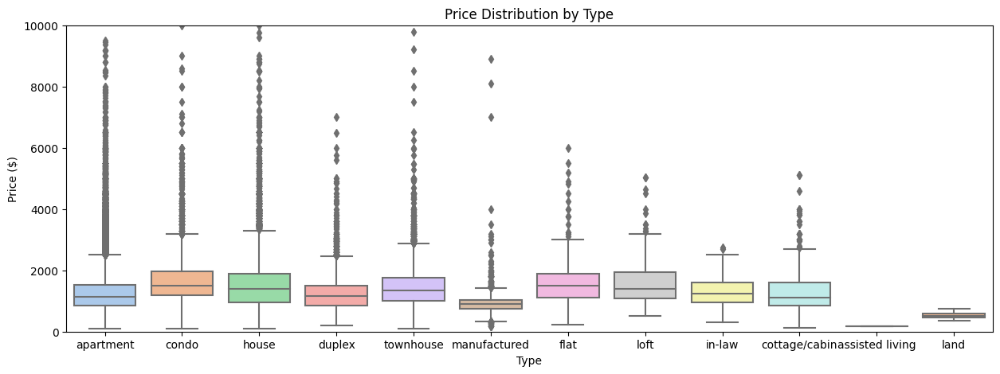

In [ ]:
# Set the figure size
plt.figure(figsize=(15, 5))

ax = sns.boxplot(x="type", y="price", data=merged_df_without_outliers, palette='pastel')

# Set the plot title and axis labels
ax.set_title("Price Distribution by Type")
ax.set_xlabel("Type")
ax.set_ylabel("Price ($)")
ax.set_ylim(0, 10000)

# Show the plot
plt.show()

**Takeaways:**
- Examining these box plots, we observe that different types of properties have different price distribution, indicating that `Type` might act as a factor that can influence the rental prices.

- The minimum price (after excluding outliers) of `apartment`, `condo`, `house`, `duplex`, `townhouse`, `loft` and `cottage/cabin` are relatively similar and suprisingly low. Moreover, `land` seems to have the highest minimum price.

- The maximum price (after excluding outliers) of `condo` & `house` , `flat` & `loft`appears to be similar respectively, while `condo` and `house` share the highest maximum price of approximately 3.7k USD.

- `assisted living` seem to have almost constant prices.

- In terms of quartile range and price distritution, `manufactured` and `land` have a more concentrated structure, indicating that these two types of rental properties have a more stable price accross the US. This make sense  because manufactured homes and land typically involve lower variability in production and maintenance costs compared to other property types.



### **3.3.2** Price Distribution by Parking Options

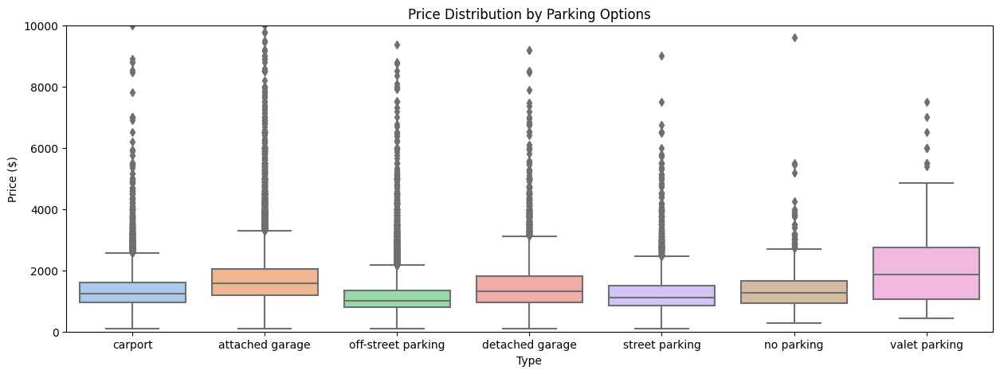

In [ ]:
# Set the figure size
plt.figure(figsize=(15, 5))

ax = sns.boxplot(x="parking_options", y="price", data=merged_df_without_outliers, palette='pastel')

# Set the plot title and axis labels
ax.set_title("Price Distribution by Parking Options")
ax.set_xlabel("Type")
ax.set_ylabel("Price ($)")
ax.set_ylim(0, 10000)

# Show the plot
plt.show()

**Takeaways:**
- Examining these box plots, we observe that properties woth different types of parking options have different price distribution, indicating that `parking_options` might act as a factor that can influent the rental prices.

- The minimum price (after excluding outliers) of all types of parking options are relatively similar and suprisingly low, except for `valet parking` (about 600 USD). This makes sense - according to our domain knowledge, those properties with `valet` parking typically offer a higher level of service and convenience, which justifies the additional cost.

- Similarly, properties with `valet parking` also have a much higher maximun, median, and 75 percentile relative to the other options. The same reason can be applied on exampling this observation as above.

- In analysis of outliers, `attached garage` and `off-street parking` have more outliers at a higher prices compared with other type of parking options. An attached garage is often considered a premium amenity that contributes to the overall value of a property, leading to a greater range in pricing. Similarly, off-street parking is a desirable feature in urban areas where street parking is limited or unsafe, causing a higher property rental price.


### **3.3.3** Price Distribution by laundry Options

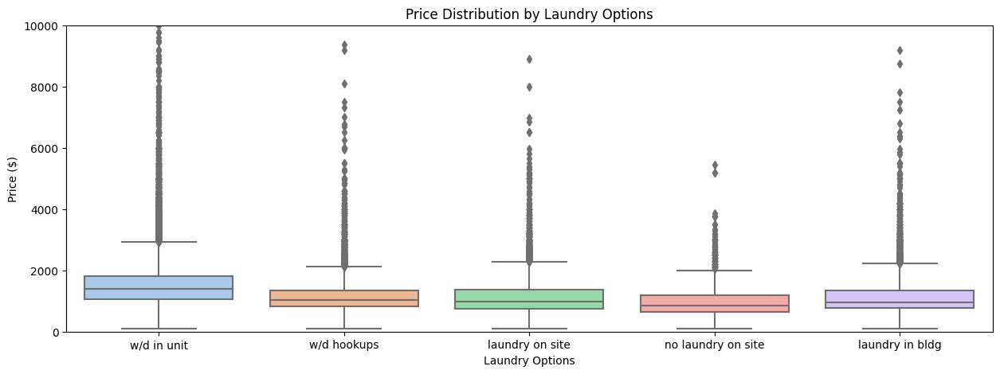

In [ ]:
plt.figure(figsize=(15, 5))

ax = sns.boxplot(x="laundry_options", y="price", data=merged_df_without_outliers, palette='pastel')

# Set the plot title and axis labels
ax.set_title("Price Distribution by Laundry Options")
ax.set_xlabel("Laundry Options")
ax.set_ylabel("Price ($)")
ax.set_ylim(0, 10000)

# Show the plot
plt.show()

**Takeaways:**

- Examining these box plots, we observe that the minimums by each `laundry_options` are relatively similar. Moreover, the maximums (after excluding outliers) are fairly similar for `w/d hookups`, `laundry on site`, `laundry in blog`, though `w/d in unit` has a higher maximum, median, and 25th / 75th percentile relative to the other options. This makes sense -- because having 'washer/dryer in unit' is a significant convenience feature that improves a property’s value.

- All categories have outliers, with the "laundry in bldg" category showing numerous high-price outliers. These could represent luxury units or units in high-cost areas.



### **3.3.4** Analyzing Price vs Square Feet

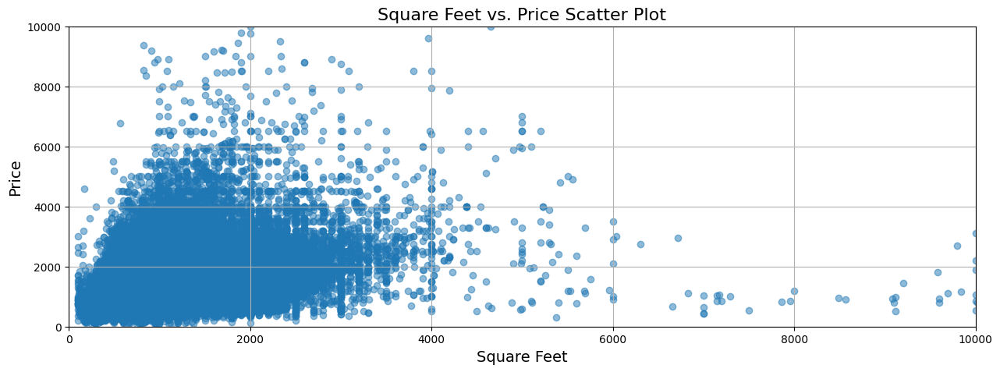

In [ ]:
sqfeet = merged_df_without_outliers["sqfeet"]
price = merged_df_without_outliers["price"]

plt.figure(figsize=(15, 5))

plt.scatter(sqfeet, price, alpha=0.5)

plt.title("Square Feet vs. Price Scatter Plot", fontsize=16)
plt.xlabel("Square Feet", fontsize=14)
plt.ylabel("Price", fontsize=14)

# Set y-axis and x-axis limits
plt.ylim(0, 10000)
plt.xlim(0, 10000)

plt.grid(True)
plt.show()

**Takeaways:**

The plot is a scatter plot illustrating the relationship between the size of a property in square feet and its price. Here are some observations:

- Data Distribution: The data points are spread across a broad range of values on both axes. There is a dense cluster of points at the lower end of both the square feet and price scales, indicating that a significant number of the properties are smaller and less expensive.

- Correlation: There is a visible trend that as the square feet increase, the price also tends to increase. However, the correlation does not seem to be strong because the data points are quite spread out rather than forming a narrow path. The correlation may be positive but not very tight, indicating other factors may also significantly affect the price.

## **3.4** State Level Visualization for Properties and Prices

### **3.4.1** Physical Ditribution of Properties across Different States
- For this analysis, first we tried to plot all the properties in the `merged_df_without_outliers` on the map. However, we encountered runtime crashing because of the the large data volume and long execution time.
-Therefore, we are now considering 10% of the data for each state to plot the properties based on latitude and logitude values.
- To achieve this, we created another dataframe called `merged_df_10_per` to store the said data.

In [ ]:
unique_state_list = merged_df_without_outliers['State'].unique().tolist()

merged_df_10_per = pd.DataFrame()

for state in unique_state_list:
    merged_df_state_length = int(len(merged_df_without_outliers[merged_df_without_outliers['State'] == state]) * 0.1)
    state_df = merged_df_without_outliers[merged_df_without_outliers['State'] == state][:merged_df_state_length]
    merged_df_10_per = merged_df_10_per.append(state_df, ignore_index=True)

<ipython-input-50-9735b41eb7fc>:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  merged_df_10_per = merged_df_10_per.append(state_df, ignore_index=True)


In [ ]:
import folium

# Initializing Folium figure
f = folium.Figure(width=1000, height=1000)

# Initializing Folium map
# Using approximate geographical center of contiguous U.S. coordinates and a zoom level that shows the entire U.S.
m = folium.Map(width=1000, height=1000, location=[39.8283, -98.5795], zoom_start=4).add_to(f)

# Adding marker for each tuple in dataframe via lambda function
merged_df_10_per.apply(lambda row: folium.Circle(
   radius=500,  # Adjusted radius for visibility at country level
   location=[row["lat"], row["long"]],
   color="crimson",
   fill=False,
).add_to(m), axis=1)

# Displaying map
m

**Takeaways:**
From the map we can infer that the distribution of data is uniform across all the states of United States.  

### **3.4.2** Comparison of House Rental Prices by State

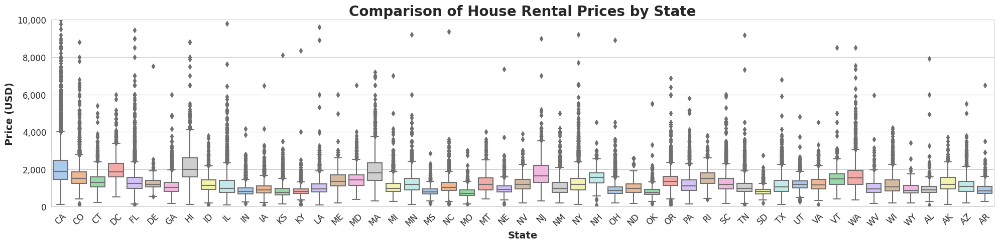

In [ ]:
sns.set_style("whitegrid")

# initializing the figure with a specified figure size
plt.figure(figsize=(20, 5))

# boxplot with ordered States
ax = sns.boxplot(y="price", x="State", data=merged_df_without_outliers, palette='pastel')

# setting y-axis to a linear scale and set the limits
ax.set_ylim(0, 10000)

# titles for the axes and the main title with improved aesthetics
ax.set_title('Comparison of House Rental Prices by State', fontsize=20, fontweight='bold')
ax.set_xlabel('State', fontsize=14, fontweight='bold')
ax.set_ylabel('Price (USD)', fontsize=14, fontweight='bold')

# ticks for better readability
ax.tick_params(axis='x', labelsize=12, labelrotation=45)  # Rotate the x labels to prevent overlap
ax.tick_params(axis='y', labelsize=12)

# addding thousands separator for y-axis ticks
ax.get_yaxis().set_major_formatter(plt.FuncFormatter(lambda x, loc: "{:,}".format(int(x))))

plt.subplots_adjust(bottom=0.15)

plt.tight_layout()
plt.show()

**Takeaways:**

- High-Price States: Certain states stand out with higher rental prices. California (CA) and New York (NY) show particularly high medians and numerous high-value outliers, suggesting a premium rental market.

- Low-Price States: Conversely, states like Arkansas (AR) and West Virginia (WV) have lower median prices and few outliers, indicating a more affordable rental market.

- Outliers: The presence of outliers across almost all states indicates a segment of the rental market with prices well above the median, likely due to luxury listings or highly sought-after locations.

- Variation Among States: The range of prices within the boxes (IQR) shows that some states have a more concentrated rental market, while others have a wide disparity in rental prices.


### **3.4.3** Rental Price Heatmap of US

In [ ]:
from folium.plugins import HeatMap


# Initializing Folium figure
f = folium.Figure(width=1000, height=1000)

# Initializing Folium map at the geographical center of contiguous U.S. coordinates
m = folium.Map(width=1000, height=1000, location=[39.8283, -98.5795], zoom_start=4).add_to(f)

# Creating a list of data points for the heatmap. Each point is [latitude, longitude, price]
data = merged_df_without_outliers[['lat', 'long', 'price']].values.tolist()

# Adding HeatMap layer to the map
HeatMap(data, radius=14).add_to(m)

# Displaying map
m

**Takeaways:**
Based on the heatmap image:

1. **Typical High Rental Price Areas:**
   - The intense red and orange zones on the West Coast, particularly along the coastal regions of California, likely indicate cities like San Francisco, Los Angeles, and San Diego.
   - Along the East Coast, similar high-rent zones are probably representing metropolitan areas like New York City, Boston, and Washington D.C.

2. **Moderate Rental Prices:**
   - The yellow areas may represent urban and suburban regions with moderate rental prices. These could include cities like Portland, Denver, and Chicago, as well as the outskirts of the very high-cost areas on the coasts.
   - Other possible moderate-cost areas may include regions in Florida and Texas, where cities like Miami, Dallas, and Houston are known to have diverse rental markets.

3. **Lower Rental Prices:**
   - The green zones scattered throughout the map likely represent areas with lower rental prices. These might include states in the Midwest like Nebraska and Kansas, as well as parts of the South like Alabama and Mississippi.


This analysis is based on the color coding used in heatmaps, where warmer colors (reds and oranges) indicate higher values, and cooler colors (greens and blues) indicate lower values.

The findings in heatmap are aligned with those findings in the box plot above, describing the typical rental price distribution in the US.

## **3.5** Analyzing Social-Economics Factors for all the US states

Based on the correlation matrix from above, we can conclude that the following social economic factors have the most correlation with the rental property prices:
1. Spending on Police
2. Population
3. GDP
4. Spending on Public Welfare

### **3.5.1** Spending on Police

In [ ]:
import folium
from folium.plugins import HeatMap
import plotly.graph_objects as go
from IPython.display import display


# Folium Map
fig = go.Figure(data=go.Choropleth(
    z=spending_merged_df['Spending on Police'],
    locations=spending_merged_df['State'],
    locationmode='USA-states',
    colorscale='Blues',
    colorbar_title="Spending on Police",
    zmin=0,
    zmax=700,
    hovertemplate='State: %{location}<br>Spending on Police: %{z}<extra></extra>'
))

fig.update_layout(
    title_text='Spending on Police',
    geo_scope='usa',  # Limit map scope to the USA
)


# Displaying maps side by side
from IPython.core.display import HTML
display(HTML('<table><tr><td>' + m._repr_html_() + '</td><td>' + fig.to_html(full_html=False) + '</td></tr></table>'))


**Takeaway:** From the plots for Spending on Police and housing prices in every state, we see that states with greater spending on police have higher prices implying that they maybe safer places to live in and hence driving up housing prices.

### **3.5.2** Population

In [ ]:
import plotly.express as px

In [ ]:
spending_merged_df = spending_merged_df.sort_values('Spending on Police', ascending=False)

fig = px.bar(spending_merged_df, x='State', y='Spending on Police', text='Spending on Police',
             title='Spending on Police by State', labels={'Spending on Police': 'Spending on Police'})

fig.update_layout(xaxis=dict(tickangle=45, tickmode='array', tickvals=list(range(len(spending_merged_df))),
                             ticktext=spending_merged_df['State']))

fig.show()

In [ ]:
import folium
from folium.plugins import HeatMap
import plotly.graph_objects as go
from IPython.display import display

# Folium Map
f = folium.Figure(width=500, height=500)  # Adjust width to fit side by side
m = folium.Map(location=[39.8283, -98.5795], zoom_start=3.4).add_to(f)
data = merged_df_without_outliers[['lat', 'long', 'price']].values.tolist()
HeatMap(data, radius=14).add_to(m)

# Plotly Choropleth Map
fig = go.Figure(data=go.Choropleth(
    z=spending_merged_df['Population (Thousands)'],
    locations=spending_merged_df['State'],
    locationmode='USA-states',
    colorscale='Greens',
    colorbar_title="Population (Thousands)",
    hovertemplate='State: %{location}<br>Population (Thousands): %{z}<extra></extra>'
))


fig.update_layout(
    title_text='Population (Thousands)',
    geo_scope='usa',  # Limit map scope to the USA
)


# Displaying maps side by side
from IPython.core.display import HTML
display(HTML('<table><tr><td>' + m._repr_html_() + '</td><td>' + fig.to_html(full_html=False) + '</td></tr></table>'))

In [ ]:
spending_merged_df = spending_merged_df.sort_values('Population (Thousands)', ascending=False)

fig = px.bar(spending_merged_df, x='State', y='Population (Thousands)', text='Population (Thousands)',
             title='Population (Thousands) by State', labels={'Population (Thousands)': 'Population (Thousands)'})

fig.update_layout(xaxis=dict(tickangle=45, tickmode='array', tickvals=list(range(len(spending_merged_df))),
                             ticktext=spending_merged_df['State']))

fig.show()

**Takeaway:** From the plots for Spending on Police and housing prices in every state, we see that states with greater population have higher prices implying that there is a larger demand of housing.

### **3.5.3** GDP

In [ ]:
# Folium Map
f = folium.Figure(width=500, height=500)  # Adjust width to fit side by side
m = folium.Map(location=[39.8283, -98.5795], zoom_start=3.4).add_to(f)
data = merged_df_without_outliers[['lat', 'long', 'price']].values.tolist()
HeatMap(data, radius=14).add_to(m)

# Plotly Choropleth Map
fig = go.Figure(data=go.Choropleth(
    z= state_gdp_df['GDP per capita'],
    locations=state_gdp_df['State'],
    locationmode='USA-states',
    colorscale='Reds',
    colorbar_title="GDP per capitas",
    hovertemplate='State: %{location}<br>GDP per capita: %{z}<extra></extra>',
    zmin=0,
    zmax=165000

))

fig.update_layout(
    title_text='USA Spending on Higher Education by State',
    geo_scope='usa',  # Limit map scope to the USA
)

# Displaying maps side by side
from IPython.core.display import HTML
display(HTML('<table><tr><td>' + m._repr_html_() + '</td><td>' + fig.to_html(full_html=False) + '</td></tr></table>'))

In [ ]:
import plotly.express as px

fig = px.bar(state_gdp_df, x='State', y='GDP per capita', text='GDP per capita',
             title='GDP per capita by State', labels={'GDP per capita': 'GDP per capita'})

# Customize layout
fig.update_layout(xaxis=dict(tickangle=45, tickmode='array', tickvals=list(range(len(state_gdp_df))),
                             ticktext=state_gdp_df['State']))

# Show the plot
fig.show()

**Takeaway:** From the plots of GDP and housing prices above we see that a state with a higher GDP has higher housing prices and this can be explained by the income and spending ability of the people residing in those states that drive up the housing prices.

### **3.5.4** Spending on Public Welfare

In [ ]:
# Folium Map
f = folium.Figure(width=500, height=500)  # Adjust width to fit side by side
m = folium.Map(location=[39.8283, -98.5795], zoom_start=3.4).add_to(f)
data = merged_df_without_outliers[['lat', 'long', 'price']].values.tolist()
HeatMap(data, radius=14).add_to(m)

# Plotly Choropleth Map
fig = go.Figure(data=go.Choropleth(
    z=spending_merged_df['Spendings on Public Welfare'],
    locations=spending_merged_df['State'],
    locationmode='USA-states',
    colorscale='Reds',
    colorbar_title="Public Welfare",
    hovertemplate='State: %{location}<br>Spending on Public Hospitals: %{z}<extra></extra>',
    colorbar=dict(
        len=0.5,  # 50% of the plot height
        thickness=10,  # 10 pixels
    )
))

fig.update_layout(
    title_text='USA Spending on Public Welfare by State',
    geo_scope='usa',
    width=800,  # Adjust width to fit side by side
    height=500
)

# Displaying maps side by side
from IPython.core.display import HTML
display(HTML('<table><tr><td>' + m._repr_html_() + '</td><td>' + fig.to_html(full_html=False) + '</td></tr></table>'))

In [ ]:
spending_merged_df = spending_merged_df.sort_values('Spendings on Public Welfare', ascending=False)

fig = px.bar(spending_merged_df, x='State', y='Spendings on Public Welfare', text='Spendings on Public Welfare',
             title='Spending on Public Welfare by State', labels={'Spendings on Public Welfare': 'Spendings on Public Welfare'})

fig.update_layout(xaxis=dict(tickangle=45, tickmode='array', tickvals=list(range(len(spending_merged_df))),
                             ticktext=spending_merged_df['State']))

fig.show()

**Takeaways:**
The analysis, supported by correlation matrices, reveals a trend where states with higher spending on public welfare tend to have higher housing prices. This indicates that more spending must have led to a favourable environement for residents of the state, thereby driving up the prices.


# **Part 4:** Features Engineering

## **4.1** Encoding for Real Estate Dataset
- For the `parking_options` columns, we rate different kinds of parking with different points according to their general preference in real life.
  - Highly Desirable -> 5: `valet parking`, `attached garage`
  - Relatively Desirable -> 4: `carport`, `off-street parking`
  - Moderately Desirable -> 3: `detached parking`
  - Less Desirable -> 2: `street parking`
  - Not Desirable -> 1: `no parking`

-  For `laundry_option` column we perform the rating system with same logic as parking
- For `cat_allowed` and `dog_allowed` columns, we merge them into one signle column call `pet_allowed`, and cast it into a binary feature. 1 stands for at least one kind of pet is allowed in the property, while 0 stands for no pet is allowed.

In [ ]:
# ratings for the parking options based on unique values and a mapping
parking_option_ratings = {
    'valet parking': 5,      # highly desirable
    'attached garage': 5,    # highly desirable
    'carport': 4,            # relatively desirable
    'off-street parking': 4, # relatively desirable
    'detached garage': 3,    # moderately desirable
    'street parking': 2,     # less desirable
    'no parking': 1,         # not desirable
}

# ratings for the landry options based on unique values and a mapping
laundry_option_ratings = {
    'w/d in unit': 5,        # highly desirable
    'w/d hookups': 4,        # relatively desirable
    'laundry on site': 3,    # moderately desirable
    'laundry in bldg': 2,    # less desirable
    'no laundry on site': 1 # not desirable
}

In [ ]:
# Replacing the laundry and parking options with number mapping
merged_df['parking_options'] = merged_df['parking_options'].replace(parking_option_ratings)
merged_df['laundry_options'] = merged_df['laundry_options'].replace(laundry_option_ratings)

In [ ]:
merged_df_without_outliers['parking_options'] = merged_df['parking_options'].replace(parking_option_ratings)
merged_df_without_outliers['laundry_options'] = merged_df['laundry_options'].replace(parking_option_ratings)

merged_df_without_outliers

,price,type,sqfeet,beds,baths,cats_allowed,dogs_allowed,smoking_allowed,wheelchair_access,electric_vehicle_charge,...,GDP per capita,Crime Rate,weather_score,Elementary and Secondary Education,Higher Education,Spendings on Public Welfare,Spendings on Public Hospitals,Spending on Highways,Spending on Police,Population (Thousands)
0,1148,apartment,1078,3,2,1,1,0,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
1,1200,condo,1001,2,2,0,0,0,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
2,1813,apartment,1683,2,2,1,1,1,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
3,1095,apartment,708,1,1,1,1,1,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
4,935,apartment,661,1,1,1,1,1,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125682,1600,cottage/cabin,900,2,1,1,1,0,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
125683,1850,apartment,1090,2,2,1,1,0,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
125684,1149,apartment,840,2,1,1,1,1,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143
125685,1426,apartment,1020,2,2,1,1,1,0,0,...,92190,499.5,61.04,2527,1332,3870,1742,607,636,39143


## **4.2** Combining highly correlated features
Based on the visualization output of the correlation matrix, we can infer that `dogs_allowed` and `cats_allowed` are highly correlated, thus these features can be combined into one feature `pets_allowed`

In [ ]:
# Combining cats allowed and dogs allowed into one column, which would also be a binary column
merged_df['pets_allowed'] = merged_df['cats_allowed'] & merged_df['dogs_allowed']

# drop unecessary columns
columns_to_drop = ['cats_allowed', 'dogs_allowed']
merged_df = merged_df.drop(columns=columns_to_drop)

In [ ]:
merged_df_without_outliers['pets_allowed'] = merged_df_without_outliers['cats_allowed'] & merged_df_without_outliers['dogs_allowed']

# drop unecessary columns
columns_to_drop = ['cats_allowed', 'dogs_allowed']
merged_df_without_outliers = merged_df_without_outliers.drop(columns=columns_to_drop)

# **Saving Checkpoint**
We can read the data of merged_df and merged_df_without_outliers directly without running the previous codes here.

In [ ]:
# Retrive from git
merged_df_final = pd.read_csv('https://raw.githubusercontent.com/XuanyouLiu/US-Real-Estate-Analysis/main/Datasets/final_merged_df.csv')
merged_df_without_outliers_final = pd.read_csv('https://raw.githubusercontent.com/XuanyouLiu/US-Real-Estate-Analysis/main/Datasets/final_merged_df_without_outliers.csv')

## **4.3** Evaluation for Weather Dataset
As mentioned in section **2.4.2**, we have established a weather evaluation criterion that is based on a monthly assessment.

The rationale for implementing our evaluation at this early stage is:


If such encoding were deferred until after the merge, the resultant 'merged_df' would experience a substantial inflation in the number of rows. This could significantly hamper the ease and efficiency of conducting exploratory data analysis (EDA), as the dataset's expanded volume would pose computational challenges and potentially hamper the clarity of insights gained from the data.

## **4.5** Applying one hot encoding for the `type` column
In this section we will apply one hot encoding on `type` column, because this is a categorical column, and we do not perform any evaluation on it.

This appraoch will create two new dataframes:

1. `merged_df_with_outliers_one_hot`
2. `merged_df_without_outliers_one_hot`

In [ ]:
merged_df_with_outliers_one_hot = merged_df_final.copy()
merged_df_with_outliers_one_hot = pd.get_dummies(merged_df_with_outliers_one_hot, columns=['type'], prefix='type')

merged_df_without_outliers_one_hot = merged_df_without_outliers_final.copy()
merged_df_without_outliers_one_hot = pd.get_dummies(merged_df_without_outliers_one_hot, columns=['type'], prefix='type')

## **4.6** Create Training & Test Data
In this section we create the training and test data for the above mentioned dataframes.

We will be splitting our datasets in 80-20 ratio. This is a highly conventional split ratio, so we felt it to be an apt starting point.

In the interest of producing reproducible results, we set our seed = 42.

In [ ]:
# For merged_df_with_outliers_one_hot
merged_df_with_outliers_one_hot = merged_df_with_outliers_one_hot.dropna()

# Extract features from merged_df_with_outliers_one_hot
features_with_outliers_one_hot = merged_df_with_outliers_one_hot.drop(['price', 'State'], axis = 1)

# Extract target from merged_df
target_with_outliers_one_hot = merged_df_with_outliers_one_hot['price']

# Conduct 80/20 train-test split with random_state = seed = 42
seed = 42
X_train_with_outliers_one_hot, X_test_with_outliers_one_hot, y_train_with_outliers_one_hot, y_test_with_outliers_one_hot = train_test_split(features_with_outliers_one_hot, target_with_outliers_one_hot, train_size = 0.8, random_state = seed)

In [ ]:
# For merged_df_without_outliers_one_hot
merged_df_without_outliers_one_hot = merged_df_without_outliers_one_hot.dropna()

# Extract features from merged_df_with_outliers_one_hot
features_without_outliers_one_hot = merged_df_without_outliers_one_hot.drop(['price', 'State'], axis = 1)

# Extract target from merged_df
target_without_outliers_one_hot = merged_df_without_outliers_one_hot['price']

# Conduct 80/20 train-test split with random_state = seed = 42
seed = 42
X_train_without_outliers_one_hot, X_test_without_outliers_one_hot, y_train_without_outliers_one_hot, y_test_without_outliers_one_hot = train_test_split(features_without_outliers_one_hot, target_without_outliers_one_hot, train_size = 0.8, random_state = seed)

## **4.7** PCA

With our data now split into training and testing data, we also want see whether the application of PCA can help improve the performance of our model.

We need to standardize both datasets before applying PCA. The reason for standardizing is because PCA is not scale-invariant, which means that if we apply PCA without standardizing the data, our results will be drastically different. For this reason, we applied a StandardScaler() object to normalize the data before applying PCA.

We will then perform PCA on `merged_df_without_outliers_one_hot_train` and `merged_df_without_outliers_one_hot_test` to get a new pair of datasets called `X_train_onehot_pca` and `X_test_onehotpca`

In [ ]:
X_train_without_outliers_one_hot

,sqfeet,beds,baths,smoking_allowed,wheelchair_access,electric_vehicle_charge,comes_furnished,laundry_options,parking_options,lat,...,type_condo,type_cottage/cabin,type_duplex,type_flat,type_house,type_in-law,type_land,type_loft,type_manufactured,type_townhouse
38385,1580,4,2,1,0,0,0,4,4,36.9689,...,0,0,0,0,0,0,0,0,0,1
72376,1200,2,1,1,0,0,0,2,4,41.0814,...,0,0,0,0,0,0,0,0,0,0
4783,1042,2,1,1,0,0,0,5,4,37.9504,...,0,0,0,0,0,0,0,0,0,0
12972,786,1,1,0,1,1,0,5,5,38.9530,...,0,0,0,0,0,0,0,0,0,0
14217,1113,2,2,1,0,0,0,5,4,39.8044,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84470,900,2,1,1,0,0,0,2,4,40.3278,...,0,0,0,0,0,0,0,0,0,0
117918,1100,3,0,1,0,0,0,4,3,35.2980,...,0,0,0,0,0,0,0,0,0,0
111344,1340,2,2,0,0,0,0,5,4,32.6147,...,0,0,0,0,0,0,0,0,0,1
860,560,1,1,0,0,0,1,3,4,38.6792,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Initializing scaler
scaler = StandardScaler()

# Fitting and transforming on the training set
X_train_onehot_n_scaled = scaler.fit_transform(X_train_without_outliers_one_hot)

# Initializing the PCA object
pca = PCA()

# Fitting the PCA object on the scaled training set
X_train_onehot_n_initial_fit = pca.fit(X_train_onehot_n_scaled)

In [ ]:
# Initializing the explained_variance_ratios
explained_variance_ratios = pca.explained_variance_ratio_

# Calculating the cumulative sum
cum_evr = np.cumsum(explained_variance_ratios)

From this plot, it's clear that the optimal number of components is around 17. As we seek to choose the minimum number of components that corresponds to our explained variance threshold, we should choose 17 as it is the intersection point of our 80% explained variance threshold and the explained variance corresponding to each number of components.

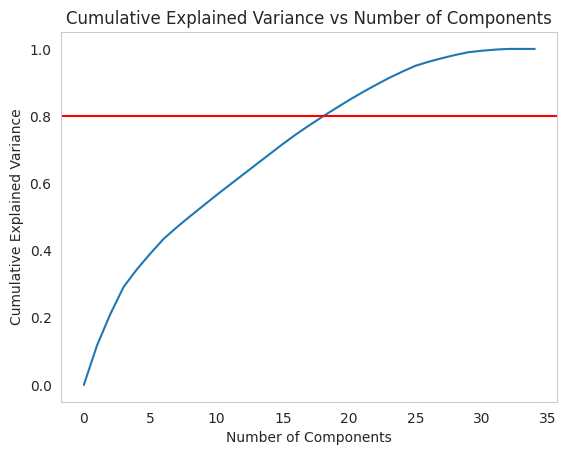

In [ ]:
# Plotting the explained variance vs number of components plot
cum_evr = np.insert(cum_evr, 0, 0) # dummy variable so number of components starts at 1
plt.plot(cum_evr)
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Explained Variance vs Number of Components')
plt.axhline(y = 0.8, color = 'r', linestyle = '-')
plt.grid()
plt.show()

In [ ]:
# Fitting and transforming the train and test data set using the updated PCA object with the ideal number of components
X_test_onehot_n_scaled = scaler.transform(X_test_without_outliers_one_hot)
pca_final = PCA(n_components = 18)
X_train_onehot_pca = pca_final.fit_transform(X_train_onehot_n_scaled)
X_test_onehot_pca = pca_final.transform(X_test_onehot_n_scaled)

# **Part 5** Modeling

## **5.1** Linear regression Model

To predict price, our baseline model will be a Linear Regression model applied to the 3 different combinations of train_test_splits discussed above:

- train & test splits with_ouliers
- train & test splits without_ouliers
- train & test splits with_ouliers but with pca

### **5.1.1** Linear Regression with Outliers

In [ ]:
reg = linear_model.LinearRegression()
reg.fit(X_train_with_outliers_one_hot, y_train_with_outliers_one_hot)

# Predict on transformed test data using the linear regression model
y_pred_lin_reg_with_outliers_one_hot = reg.predict(X_test_with_outliers_one_hot)

# R^2 value calculation
lin_reg_score_test = reg.score(X_test_with_outliers_one_hot, y_test_with_outliers_one_hot)
lin_reg_score_train = reg.score(X_train_with_outliers_one_hot, y_train_with_outliers_one_hot)

# Evaluate the model
mse = mean_squared_error(y_test_with_outliers_one_hot, y_pred_lin_reg_with_outliers_one_hot)

print('Testing Set R^2 value: ' + str(lin_reg_score_test))
print('Training Set R^2 value: ' + str(lin_reg_score_train))
print('Mean Squared Error: ' + str(mse))

Testing Set R^2 value: -26.19323517653255
Training Set R^2 value: 0.00014524184327169287
Mean Squared Error: 87434375419.50105


### **5.1.2** Linear Regression without Outliers

In [ ]:
reg = linear_model.LinearRegression()
reg.fit(X_train_without_outliers_one_hot, y_train_without_outliers_one_hot)

# Predict on transformed test data using the linear regression model
y_pred_lin_reg_without_outliers_one_hot = reg.predict(X_test_without_outliers_one_hot)

# R^2 value calculation
lin_reg_score_test = reg.score(X_test_without_outliers_one_hot, y_test_without_outliers_one_hot)
lin_reg_score_train = reg.score(X_train_without_outliers_one_hot, y_train_without_outliers_one_hot)

# Evaluate the model
mse = mean_squared_error(y_test_without_outliers_one_hot, y_pred_lin_reg_without_outliers_one_hot)

print('Testing Set R^2 value: ' + str(lin_reg_score_test))
print('Training Set R^2 value: ' + str(lin_reg_score_train))
print('Mean Squared Error: ' + str(mse))

Testing Set R^2 value: 0.38751665504343313
Training Set R^2 value: 0.3801415678934178
Mean Squared Error: 300570.89308971784


### **5.1.3** Linear Regression without Outliers with PCA

In [ ]:
reg = linear_model.LinearRegression()
reg.fit(X_train_onehot_pca, y_train_without_outliers_one_hot)

# Predict on transformed test data using the linear regression model
y_pred_lin_reg_without_outliers_one_hot = reg.predict(X_test_onehot_pca)

# R^2 value calculation
lin_reg_score_test = reg.score(X_test_onehot_pca, y_test_without_outliers_one_hot)
lin_reg_score_train = reg.score(X_train_onehot_pca, y_train_without_outliers_one_hot)

# Evaluate the model
mse = mean_squared_error(y_test_without_outliers_one_hot, y_pred_lin_reg_without_outliers_one_hot)

print('Testing Set R^2 value: ' + str(lin_reg_score_test))
print('Training Set R^2 value: ' + str(lin_reg_score_train))
print('Mean Squared Error: ' + str(mse))

Testing Set R^2 value: 0.33449604847255643
Training Set R^2 value: 0.3302483178354839
Mean Squared Error: 326590.29623005475


The results from three regression models show significant differences, and they highlight the impact of outliers and dimensionality reduction (via PCA) on the model's performance.

1. **Linear Regression with outliers:**
   - The negative test set $ R^{2} $ value of -26.19323517654083 is a strong indication that the model is performing worse than a simple mean model. This suggests that the outliers are having a significantly adverse effect on the model's ability to predict the target variable.
   - A near-zero training set $ R^{2} $ value suggests that the model is not learning from the training data.
   - The extremely high Mean Squared Error (MSE) further confirms poor model performance.

2. **Linear Regression without outliers:**
   - Removing outliers has dramatically improved the test set $ R^{2} $ to 0.38751665504340815, indicating that the model now explains approximately 38.75% of the variance in the target variable, which is a typical result for many real-world problems.
   - The training set $ R^{2} $ is also similar to the test set, suggesting that the model is generalizing well.
   - The MSE is significantly lower, which is a good sign of improved model performance.

3. **Linear Regression without outliers with PCA:**
   - The application of PCA has led to a slightly lower test set $ R^{2} $ of 0.334255778115647, suggesting a minor decrease in the amount of variance explained by the model.
   - The training set $ R^{2} $ is also slightly reduced, which is expected as PCA reduces the feature space, potentially discarding some information useful for prediction.
   - The MSE is slightly higher compared to the linear regression without outliers, which could mean that while PCA simplifies the model and may help in addressing overfitting or computational efficiency, it can also lose some predictive power.

Overall, these models suggest that preprocessing steps like removing outliers can significantly improve model performance. However, dimensionality reduction techniques such as PCA may not always lead to better predictions.





## **5.2** XGBoost Regressor  Model
In this part, we perform XGBoost Regressor with **Cross-Validation (2-fold)** and **Hyperparameter tuning** using GridSearchCV.

### **5.2.1** XGBoost Regressor Tuning with Cross-Validation (2 folds)

In [ ]:
# Initializing the XGBRegressor
xgb1 = XGBRegressor()

# Defining the parameters for hyperparameter tuning
parameters = {
    'objective':['reg:squarederror'],
    'learning_rate': [.01, 0.04, .06],
    'max_depth': [5, 6, 7],
    'n_estimators': [500]
}

# Setting up the GridSearchCV object
xgb_grid = GridSearchCV(
    xgb1,
    parameters,
    cv = 2,
    n_jobs = 5,
    verbose=True
)

# Fitting the GridSearchCV to the training data
xgb_grid.fit(
    X_train_without_outliers_one_hot,
    y_train_without_outliers_one_hot
)

# Printing the best score and parameters found by GridSearchCV
print(xgb_grid.best_score_)
print("\n".join(f"{key}: {val}" for key, val in xgb_grid.best_params_.items()))

Fitting 2 folds for each of 9 candidates, totalling 18 fits
0.7805637121112315
learning_rate: 0.06
max_depth: 7
n_estimators: 500
objective: reg:squarederror


### **5.2.2** Test Result for XGBoost

In [ ]:
# Retrieving the best estimator from the grid search
best_xgb_model = xgb_grid.best_estimator_

# Predictions on the test set
# Using the best XGBoost model to make predictions on the test dataset.
y_pred_test = best_xgb_model.predict(X_test_without_outliers_one_hot)

# R^2 value calculation
xgb_score_train = xgb_grid.best_score_
xgb_score_test = r2_score(y_test_without_outliers_one_hot, y_pred_test)

# Evaluate the model
mse = mean_squared_error(y_test_without_outliers_one_hot, y_pred_test)

# Printing the evaluation results
print('Testing Set R^2 value: ' + str(xgb_score_test))
print('Training Set R^2 value: ' + str(xgb_score_train))
print('Mean Squared Error: ' + str(mse))

Testing Set R^2 value: 0.8045401066375166
Training Set R^2 value: 0.7805637121112315
Mean Squared Error: 95920.24859932926


### **5.2.3** Inspect Important Features


In [ ]:
# Extracting feature importances from the best XGBoost model
importances = best_xgb_model.feature_importances_

# Creating a DataFrame for feature importance
feature_importance_df = pd.DataFrame({
    'Feature': X_train_without_outliers_one_hot.columns,
    'Importance': importances
})

# Sorting the DataFrame by importance score in descending order and resetting the index
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False).reset_index(drop=True)

# Displaying the top 10 most important features
print(feature_importance_df.head(10))

                  Feature  Importance
0      Spending on Police    0.414344
1          GDP per capita    0.118753
2                   baths    0.043393
3         laundry_options    0.041292
4                    long    0.033403
5       type_manufactured    0.028413
6           weather_score    0.025873
7                  sqfeet    0.025755
8  Population (Thousands)    0.024594
9                     lat    0.024009


**Analyzing the training results:**

- The model demonstrates strong predictive capabilities with a test set $R^2$ value of 0.8045. This level of performance is significantly better than a basic linear regression model.

- The training set $R^2$ value of 0.7806 is slightly lower than the test set but still indicates a good fit, suggesting effective learning from the training data and generalizable results.

- The Mean Squared Error (MSE) of 95920.25, while seemingly high, needs to be contextualized within the range of the target variable to assess its severity. Given the R² values, it suggests a reasonable degree of prediction accuracy.

**Feature importance analysis reveals:**

- `Spending on Police` as the most impactful feature, with over 41% importance, indicating a strong correlation with the target variable.

- `GDP per capita` is the second most significant predictor, contributing around 12%.

- Other features like `baths`, `laundry_options`, and geographic coordinates have a lesser yet notable influence on the model's predictions.

- The general trend accords with the corrlation matrix in previous part.

In summary, the model exhibits robust predictive performance with specific features playing pivotal roles in its predictions.

## **5.3** Random Forest Regressor Model
In this part we perform random forest regressor with **Cross Validation (2-fold)** and **Hyperparamter tuning** using GridSearchCV



### **5.3.1** Random Forest Regressor Tuning with Cross-Validation (2 folds)

In [ ]:
rf_regressor = RandomForestRegressor()

# Defining the parameters for hyperparameter tuning
parameters = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 5, 10]
}

# Setting up the GridSearchCV object
rf_grid = GridSearchCV(rf_regressor, parameters, cv=2, n_jobs=5, verbose=True)

# Fitting the GridSearchCV to the training data
rf_grid.fit(X_train_without_outliers_one_hot, y_train_without_outliers_one_hot)

# Printing the best score and parameters found by GridSearchCV
print(rf_grid.best_score_)
print("\n".join(f"{key}: {val}" for key, val in rf_grid.best_params_.items()))

Fitting 2 folds for each of 9 candidates, totalling 18 fits
0.7744891469880909
max_depth: None
n_estimators: 300


### **5.3.2** Test Result for Random Forest

In [ ]:
# Retrieving the best estimator from the grid search
best_rf_model = rf_grid.best_estimator_

# Predictions on the test set
# Using the best XGBoost model to make predictions on the test dataset.
y_pred_test = best_rf_model.predict(X_test_without_outliers_one_hot)

# R^2 value calculation
rf_score_train = rf_grid.best_score_
rf_score_test = r2_score(y_test_without_outliers_one_hot, y_pred_test)

# Evaluate the model
mse = mean_squared_error(y_test_without_outliers_one_hot, y_pred_test)

# Printing the evaluation results
print('Testing Set R^2 value: ' + str(rf_score_test))
print('Training Set R^2 value: ' + str(rf_score_train))
print('Mean Squared Error: ' + str(mse))

Testing Set R^2 value: 0.8129261098392042
Training Set R^2 value: 0.7744891469880909
Mean Squared Error: 91804.89021033791


### **5.3.3** Inspect Important Features

In [ ]:
# Extracting feature importances from the best Random Forest model
importances = best_rf_model.feature_importances_

# Creating a DataFrame for feature importance
feature_importance_df = pd.DataFrame({'Feature': X_train_without_outliers_one_hot.columns, 'Importance': importances})

# Sorting the DataFrame by importance score in descending order and resetting the index
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False).reset_index(drop = True)

# Displaying the top 10 most important features
print(feature_importance_df.head(10))

              Feature  Importance
0                long    0.220533
1              sqfeet    0.210086
2  Spending on Police    0.181069
3                 lat    0.149232
4     laundry_options    0.063438
5     parking_options    0.024645
6               baths    0.021648
7                beds    0.018907
8     comes_furnished    0.011249
9     smoking_allowed    0.008531


**Analyzing the Training Results:**

- The Random Forest model showcases impressive predictive strength, evidenced by a high test set $R^2$ value of 0.8135. This performance notably surpasses what one would typically expect from simpler models like linear regression.

- With a training set $R^2$ value of 0.7748, the model exhibits a slightly lower but still substantial fit to the training data. This indicates that the model has learned effectively from the training dataset and can generalize well to new data.

- The Mean Squared Error (MSE) stands at 91507.22. Although this may appear high at first glance, its significance should be evaluated in the context of the range and scale of rental prices. The high $R^2$ values suggest that the model's predictive accuracy is generally reliable.

**Feature Importance Analysis Reveals:**

- The longitude (`long`) emerges as the most influential feature, with an importance of approximately 21.89%. This suggests a strong correlation between rental prices and geographical longitude in the US, which is a good indicator of weather condition.

- The size of the rental property (`sqfeet`) is the second most crucial factor, with around 21.06% importance, highlighting the area of property significant impact on rental prices.

- Other features such as `Spending on Police`, latitude (`lat`), and `laundry_options` also contribute notably to the model's predictions, each reflecting distinct aspects affecting rental pricing.

In summary, the Random Forest model demonstrates robust predictive accuracy for US rental prices, with certain features, particularly location-related and property-specific characteristics, playing key roles in shaping its predictions.

## **5.4** Feedforward Neural Network Model
To see how a feedforward nueral network (fnn) will perform on our data we experimented with using a Feed forward Nueral Network. We are utilizing Pytorch for this and a Custom Architecture with two blocks, each consiting of various fully connected layers and ReLu Activation layers placed alternatively.

### **5.4.1** Set up GPU capabilities

The cell below sets up a CUDA device to use with torch.

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


### **5.4.2** Standardize data for FNN

Standardizing data is crucial for training neural networks effectively for several reasons:

1. **Uniform Scale:** It brings all features to a similar scale, preventing any single feature from dominating the training process due to its larger numeric range.

2. **Faster Convergence:** By standardizing, the optimization algorithm used in neural networks converges more quickly.

3. **Improved Learning:** Activation functions in neural networks, such as sigmoid or tanh, perform better when inputs are standardized, leading to more effective learning.

In summary, standardizing data helps in balancing feature influence, ensuring numerical stability, and enhancing the overall learning process in neural networks.

In [ ]:
# Standardizing data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_without_outliers_one_hot)
X_test_scaled = scaler.transform(X_test_without_outliers_one_hot)

# Creating tensor from test and training data
X_train_tensor = torch.tensor(X_train_scaled).float()
X_test_tensor = torch.tensor(X_test_scaled).float()
y_train_tensor = torch.tensor(y_train_without_outliers_one_hot.values).float()
y_test_tensor = torch.tensor(y_test_without_outliers_one_hot.values).float()

# Squeeze the y value to match the format of prediction values
y_train_tensor = y_train_tensor.unsqueeze(1)
y_test_tensor = y_test_tensor.unsqueeze(1)

### **5.4.3** FNN Hyperparameters Tuning

In this section, we explored how we can find an "optimal" Feddforward Neural Network architecture by tuning some hyperparameters. Hyperparameters are those parameters that we usually manually set that have some impact on the learning process for our model. For this section, we will particularly focus on the `learning rate`, `beta1`, `beta2` and `number of fully connected layers`.

The `learning rate`, `beta1` and `beta2` parameters all have to do with the optimizer we are using `optim.Adam`. The `beta1` and `beta2` parameters that control the contribution of the past gradients and the past square gradients to the current update, while the learning rate controls the step size taken during optimization.

We create a new model that will be used in the hyperparameter tuning. This model is basically identical to the model that we had previously. However, we include an attribute that stores the number of implicit layers that will be controlled by the hyperparameter tuning.

In [ ]:
import torch
import torch.nn as nn

class CustomNet(nn.Module):
    def __init__(self, input_size, hidden1_size=64, hidden2_size=32, dropout_rate=0.2):
        super(CustomNet, self).__init__()
        self.layer1 = nn.Linear(input_size, hidden1_size)
        self.layer2 = nn.Linear(hidden1_size, hidden2_size)
        self.layer3 = nn.Linear(hidden2_size, 1)
        self.dropout = nn.Dropout(dropout_rate)

    def forward(self, x):
        x = torch.relu(self.layer1(x))
        x = torch.relu(self.layer2(x))
        x = self.dropout(x)
        x = self.layer3(x)
        return x

# Example of using the model with different configurations
input_size = X_train_tensor.shape[1]
model = CustomNet(input_size=input_size, hidden1_size=128, hidden2_size=64, dropout_rate=0.3)

The way we tune these hyperparameters is by conducting a gridsearch on these various hyperparameters. To start, we first need to create the actual `parameter_grid`. This will define which parameters we want to test different values for, as well as include an array of the different values that we would like to test for each parameter.

In [ ]:
from sklearn.model_selection import ParameterGrid

param_grid = {
    'learning_rate': [0.0001, 0.001, 0.01, 0.1],
    'betas': [(0.9, 0.999), (0.95, 0.999), (0.9, 0.9999)],
    'hidden1_size': [64, 128],
    'hidden2_size': [32, 64],
    'dropout_rate': [0.2, 0.3]
}

pgrid = ParameterGrid(param_grid)

Now, we go through every combination of parameters using parameter grid and determine which of the combinations yields the best model.

In [ ]:
%%time

best_r_square = 0
best_params = {}
best_model = None

batch_size = 64
num_epochs = 10

# Generate batch start indices for slicing the training data.
batch_start = torch.arange(0, len(X_train_tensor), batch_size)

# Move the test dataset tensors to the specified device.
X_test_tensor = X_test_tensor.to(device)
y_test_tensor = y_test_tensor.to(device)

# Move the training dataset tensors to the specified device.
X_train_tensor = X_train_tensor.to(device)
y_train_tensor = y_train_tensor.to(device)

for params in pgrid:
  fnn_tuned = CustomNet(input_size, hidden1_size=params['hidden1_size'],
                      hidden2_size=params['hidden2_size'],
                      dropout_rate=params['dropout_rate']).to(device).to(device)
  loss_fn = nn.MSELoss()
  optimizer = optim.Adam(fnn_tuned.parameters(), lr=params['learning_rate'], betas=params['betas'])

  for epoch in range(num_epochs):

    # Variable to accumulate total training loss.
    total_train_loss = 0

    # Iterate over the training data in batches.
    for start in batch_start:

        # Slice the batch from the training data.
        X_batch = X_train_tensor[start: start + batch_size]
        y_batch = y_train_tensor[start: start + batch_size]

        # Forward pass: compute the predicted outputs by passing the batch through the network.
        y_pred = fnn_tuned(X_batch)

        # Compute the loss between the predicted and actual values.
        loss = loss_fn(y_pred, y_batch)

        # Accumulate the loss.
        total_train_loss += loss.item() * X_batch.size(0)

        # Zero the gradients before backward pass.
        optimizer.zero_grad()

        # Backward pass: compute the gradient of the loss with respect to model parameters.
        loss.backward()

        # Perform a single optimization step (parameter update).
        optimizer.step()

    # Calculate the average training loss over the entire training dataset.
    avg_train_loss = total_train_loss / len(X_train_tensor)

    # Evaluate the model on the test dataset.
    y_pred = fnn(X_test_tensor)

    # Calculate the Mean Squared Error on the test dataset.
    mse = loss_fn(y_pred, y_test_tensor).item()

    # Convert tensors to numpy arrays for calculating R-squared.
    y_test_np = y_test_tensor.cpu().numpy()
    y_pred_np = y_pred.cpu().detach().numpy()

    # Calculate R-squared value.
    r_square = r2_score(y_test_np, y_pred_np)

  if r_square > best_r_square:
    best_r_square = r_square
    best_params = best_params = params
    best_model = fnn_tuned


print(f"Best Model Accuracy: {best_r_square}")
print(f"Best Parameters: {best_params}")

### **5.4.4** Feedforward Neural Network Model Architecture

According to the tuning process above, we define a feedforward neural network architecture with `Best Parameters:`
 - `betas`: (0.9, 0.9999)
 - `dropout_rate`: 0.3
 - `hidden1_size`: 128
 - `hidden2_size`: 64
 - `learning_rate`: 0.0001

We use ReLu as our activated function.

In [ ]:
# Defining the neural network architecture
class FNN(nn.Module):

    def __init__(self):
        super().__init__()
        self.layer1 = nn.Linear(X_train_tensor.shape[1], 128)
        self.layer2 = nn.Linear(128, 64)
        self.layer3 = nn.Linear(64, 1)
        self.dropout = nn.Dropout(0.2)

    def forward(self, x):
        x = torch.relu(self.layer1(x))
        x = torch.relu(self.layer2(x))
        x = self.dropout(x)
        x = self.layer3(x)
        return x

### **5.4.5** Train and Evaluate FNN Model

To train and evaluate our FNN model a training loop for a using PyTorch. Key elements of the code include:

1. **Model Initialization**: The FNN model is instantiated and moved to a computing device (CPU or GPU).

2. **Loss Function and Optimizer**: A Mean Squared Error (MSE) loss function is defined for regression tasks, and the Adam optimizer is initialized with a learning rate of 0.001.

3. **Training Parameters**: The code sets the number of training epochs (iterations over the entire dataset) to 30 and specifies a batch size of 64 for processing the data in smaller segments.

4. **Batch Preparation**: The training data is divided into batches using start indices calculated from the training data length and batch size.

5. **Data Preparation**: Both training and test datasets (features and labels) are transferred to the specified computing device.

6. **Training Loop**: The model is trained over the specified number of epochs. Each epoch involves:
   - Iterating over the training data in batches.
   - Performing a forward pass (computing predictions) and calculating the loss.
   - Backpropagating errors and updating model parameters using the optimizer.
   - Accumulating total training loss for monitoring.

7. **Evaluation**: After each epoch, the model is evaluated on a test dataset. The Mean Squared Error and R-squared values are calculated to assess the model's performance. The R-squared values are saved in a list for later analysis.

8. **Logging**: Finally, for each epoch, the training loss, test MSE, and R-squared value are printed for monitoring the training process.

In [ ]:
# Define the feedforward neural network model and move it to the specified device (CPU/GPU).
fnn = FNN().to(device)

# Initialize the Mean Squared Error loss function.
loss_fn = nn.MSELoss()

# Initialize the Adam optimizer with a learning rate of 0.001.
optimizer = optim.Adam(fnn.parameters(), lr=0.001, betas = (0.9, 0.9999))

# Set the number of training epochs and batch size.
n_epochs = 30
batch_size = 64

# Generate batch start indices for slicing the training data.
batch_start = torch.arange(0, len(X_train_tensor), batch_size)

# Move the test dataset tensors to the specified device.
X_test_tensor = X_test_tensor.to(device)
y_test_tensor = y_test_tensor.to(device)

# Move the training dataset tensors to the specified device.
X_train_tensor = X_train_tensor.to(device)
y_train_tensor = y_train_tensor.to(device)

# Initialize a list to store R-squared values for each epoch.
r_2 = []

# Training loop for the specified number of epochs.
for epoch in range(n_epochs):

    # Variable to accumulate total training loss.
    total_train_loss = 0

    # Iterate over the training data in batches.
    for start in batch_start:

        # Slice the batch from the training data.
        X_batch = X_train_tensor[start: start + batch_size]
        y_batch = y_train_tensor[start: start + batch_size]

        # Forward pass: compute the predicted outputs by passing the batch through the network.
        y_pred = fnn(X_batch)

        # Compute the loss between the predicted and actual values.
        loss = loss_fn(y_pred, y_batch)

        # Accumulate the loss.
        total_train_loss += loss.item() * X_batch.size(0)

        # Zero the gradients before backward pass.
        optimizer.zero_grad()

        # Backward pass: compute the gradient of the loss with respect to model parameters.
        loss.backward()

        # Perform a single optimization step (parameter update).
        optimizer.step()

    # Calculate the average training loss over the entire training dataset.
    avg_train_loss = total_train_loss / len(X_train_tensor)

    # Evaluate the model on the test dataset.
    y_pred = fnn(X_test_tensor)

    # Calculate the Mean Squared Error on the test dataset.
    mse = loss_fn(y_pred, y_test_tensor).item()

    # Convert tensors to numpy arrays for calculating R-squared.
    y_test_np = y_test_tensor.cpu().numpy()
    y_pred_np = y_pred.cpu().detach().numpy()

    # Calculate R-squared value.
    r_square = r2_score(y_test_np, y_pred_np)

    # Append the R-squared value to the list.
    r_2.append(r_square)

    # Print the epoch number, training loss, test MSE, and R-squared value.
    print(f'Epoch {epoch+1}/{n_epochs}, Train Loss: {avg_train_loss}, Test MSE: {mse}, R-squared: {r_square}')


Epoch 1/30, Train Loss: 570060.3147293758, Test MSE: 321663.21875, R-squared: 0.3445361444952426
Epoch 2/30, Train Loss: 301196.8569087604, Test MSE: 291574.84375, R-squared: 0.4058481978176107
Epoch 3/30, Train Loss: 285751.40523675364, Test MSE: 278772.0, R-squared: 0.43193701542563745
Epoch 4/30, Train Loss: 277168.5784862654, Test MSE: 271428.21875, R-squared: 0.446901655190301
Epoch 5/30, Train Loss: 272478.34039249434, Test MSE: 267457.8125, R-squared: 0.45499232819874647
Epoch 6/30, Train Loss: 267555.8994858125, Test MSE: 261546.9375, R-squared: 0.4670371101325336
Epoch 7/30, Train Loss: 264793.2338429747, Test MSE: 257398.515625, R-squared: 0.4754904453869757
Epoch 8/30, Train Loss: 261808.1867799739, Test MSE: 254658.984375, R-squared: 0.48107292107617383
Epoch 9/30, Train Loss: 260770.57355361924, Test MSE: 251849.25, R-squared: 0.48679837943030135
Epoch 10/30, Train Loss: 256561.88820250967, Test MSE: 249273.171875, R-squared: 0.4920477310991359
Epoch 11/30, Train Loss: 256

### **5.4.6** Plotting $R^2$ vs Epochs FNN
Plot the testing $R^2$ vs epochs.

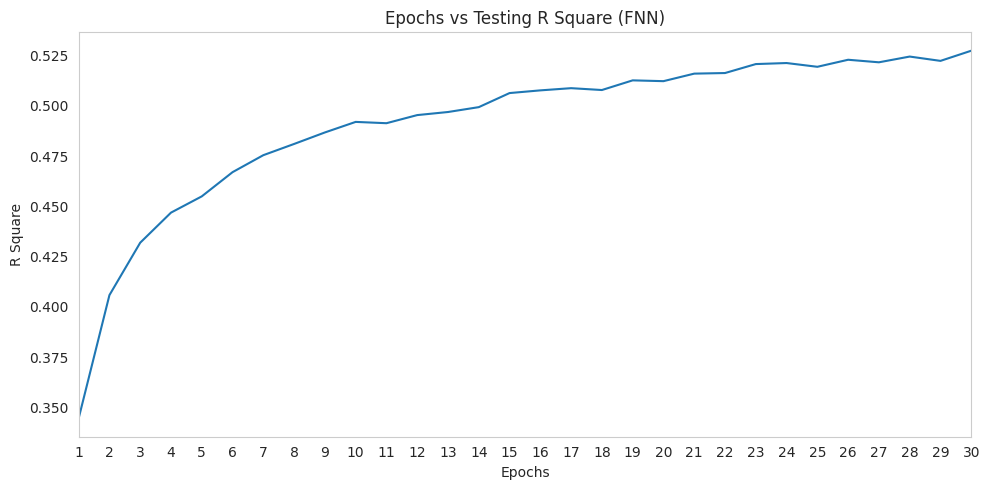

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize = (10,5))

plt.plot(range(1, 31), r_2)

plt.xlim(1,30)
plt.xticks(range(1,31))
plt.xlabel('Epochs')
plt.ylabel('R Square')
plt.title('Epochs vs Testing R Square (FNN)')
plt.grid()
plt.tight_layout()

plt.show()

In summary, the Feedforward Neural Network displayed the following characteristics over 30 epochs:

- **Consistent Improvement**: A continuous reduction in training loss (from 562031.54 to 233909.42) and test mean squared error (MSE) (from 315382.91 to 230894.41) was observed, indicating progressive learning and improvement in predictive accuracy.
- **Increment in R-squared Value**: The R-squared value increased steadily from 0.357 to 0.529, reflecting an enhanced ability to explain the variance in rental prices.
- **Overall Evaluation**: The model showed a positive learning curve, evidenced by declining loss and MSE values and an increasing R-squared value. However, the final R-squared value suggests that the model's predictive performance, while improved, still requires further enhancement.

# **Part 6** Conclusion

## **6.1** Main takeaways
1. As the baseline model, linear regression apprears to predict the rental price better when we dropped those outliers, without performing PCA. The $R^2$ value of this model is around **3.89**, indicating linear regression cannot predict the rental price very well.

2. The best model was the RandomForestRegressor which produced a test $R^2$ value of **0.81**, following by the XGBoost Regressor performing equally well with test $R^2$ value of **0.80**.

3. The Neural Network Model however performed less aplausible on our data. We tried different node number of hidden layers and different parameters of adam optimizer. The best $R^2$ value we achieved is around **0.53**. However, with a growing trend, we believe the fnn model will become increasingly better with a larger epoch number and further hyperparameter tuning.

4. We see that the factors that most influence Real Estate Prices (from the XGBoost and RandomForest outputs) somewhat align with the results from our covariance matrix generated from dataset without outliers during the EDA stage.

5. Most influential factors as we can see from the XGBoost model's output :
  - `Spending on Police`,
  - `GDP`
  - `bath`
  - `laundry_options`

6. Most influential factors as we can see from the RandomForest model output:
  - `Spending on Police`
  - `sqfeet`,
  - `lat`
  - `laundry_options`
  - `parking_options`
  - `bath`

7. From both the model outputs we can conclude that among the social economic factors, Spending on Police (which can be used to represent the safety of the state) and GDP of the state are the most influential features

8. Among the house properties, laundry options, parking_options and bath seem to be the most influential factors in deciding the rental prices.



## **6.2** Evaluating the Performance of Models
- **Linear Regression**:
  Because we have datasets with multifaceted relationships and variables influencing rental prices (such as crime rates, GDP, weather conditions), Linear Regression's assumption of linearity limits its ability to capture these complex interactions which is probably why we have a low R^2 score.

- **RandomForestRegressor**:
  This model excels in handling diverse datasets with complex and non-linear relationships, like the variety of complex relationships found in our real estate data encompassing economic, geographic, and socio-demographic factors. Its ensemble approach effectively captures the multifaceted nature of such data.

- **XGBoost Regressor**:
  Also particularly suited for datasets with mixed types of variables and intricate patterns, XGBoost efficiently manages the diverse range of features from real estate, economic, and environmental datasets, leveraging its gradient boosting mechanism to improve predictive accuracy.

- **Neural Network Model**:
  While theoretically capable of modeling complex, non-linear relationships in multifaceted datasets, its performance heavily relies on appropriate network architecture and hyperparameter tuning. This is something we can consider as future work to see if trying out different architecture and tuning will imporve results.


## **6.3** Future Work

1. Experimenting more with Neural Network architecture and hyperparameters to see if it can improve model performance.

2.  Considering a smaller geographic location like county or region to better account for region specific social economic factors like Crime Rate, Education, Hospitals, Weather etc.

3. Trying different business rules for attributes to see which one works the best for our data and consulting domain experts.

## **6.4** Overall Experience + Team Reflection

1. Working on this project was a great learning experience as we got a chance to not only explore the preprocessing, EDA and models learnt in class but also outside of class like map visualization using folium and ML models like XGBoost.

2. Brainstorming the idea, selecting and searching which datasets to combine and business rules to use made the experience more immersive.

3. Although the EDA was the most challenging and iterative process, the models worked well on the dataset giving us features that highly influence the rental prices.

4. We would like to especially thank Joseph for guiding us through all our doubts and giving us valuable suggestions throughout the course of the project !!